In [1]:
%matplotlib inline

In [2]:
import pulp
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import pandas as pd
import numpy as np
from random import shuffle
from mpl_toolkits.mplot3d import Axes3D

In [3]:
# Hyper Parameters
LR = 0.2                   # learning rate
EPSILON = 0.7               # greedy policy
GAMMA = 0.9                 # reward discount
LAMBDA = 0.9                # parameter decay

N_ACTIONS = 10 #no. of duty cycles (0,1,2,3,...,10)
BMIN = 0.0
BMAX = 20000.0 #Battery capacity
BOPT = 0.6 * BMAX #Assuming 60% of battery is the optimal level
HMAX = 1000
DMAX = 500
DMIN = 100

In [4]:
class ENO(object):
    def __init__(self, year=2010):
        self.year = year
        self.day = None
        self.hr = None
        
        self.TIME_STEPS = None
        self.NO_OF_DAYS = None
        
        self.BMIN = BMIN
        self.BMAX = BMAX #Battery capacity
        self.BOPT = 0.6 * self.BMAX #Assuming 60% of battery is the optimal level
        self.HMAX = HMAX
        
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #matrix with forecast values for each day
        
        self.batt = None #battery variable
        self.enp = None #enp at end of hr
        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
    
    #function to map total day energy into day_state
    def get_day_state(self,tot_day_energy):
        if (tot_day_energy < 2500):
            day_state = 0
        elif (2500 <= tot_day_energy < 5000):
            day_state = 1
        elif (5000 <= tot_day_energy < 8000):
            day_state = 2
        elif (8000 <= tot_day_energy < 10000):
            day_state = 3
        elif (10000 <= tot_day_energy < 12000):
            day_state = 4
        else:
            day_state = 5
        return int(day_state)

    #function to get the solar data for the given year and prep it
    def get_data(self):
        filename = str(self.year)+'.csv'
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(filename, skiprows=4, encoding='shift_jisx0213', usecols=[4])
        
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values
        solar_energy = np.array([i *0.0165*1000000*0.15*1000/(60*60) for i in solar_radiation])
        
        #reshape solar_energy into no_of_daysx24 array
        _senergy = solar_energy.reshape(-1,24)
        _senergy[np.isnan(_senergy)] = 0 #convert missing data in CSV files to zero
        self.senergy = np.clip(_senergy,0,self.HMAX) #limit the amount of harvested energy to HMAX        
        
        #create a perfect forecaster
        tot_day_energy = np.sum(_senergy, axis=1) #contains total energy harvested on each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_energy)
        
        return 0
    
    def reset(self):
        
        self.get_data() #first get data for the given year
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        print("Environment is RESET")
        
        self.day = 0
        self.hr = 0
        
        self.batt = self.BOPT #battery returns to optimal level
        self.enp = self.BOPT - self.batt #enp is reset to zero
        self.henergy = self.senergy[self.day][self.hr] 
        self.fcast = self.fforecast[self.day]
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        reward = 0
        done = False
        info = "RESET"
        return [state, reward, done, info]
    
    
    #reward function
    def rewardfn(self):
        mu = 0
        sig = 1000
        norm_enp = self.enp/(self.BMAX/2)
        if(np.abs(norm_enp) <= DMIN*self.TIME_STEPS/(BMAX/2)): # DMIN*self.TIME_STEPS/(BMAX/2) - normalized value of worst case power consumption at min duty cycle
            return ((1./(np.sqrt(2.*np.pi)*sig)*np.exp(-np.power((self.enp - mu)/sig, 2.)/2)) * 1E6)
        else:
            return -100 - 0.05*np.abs(self.enp)
    
    def step(self, action):
        done = False
        info = "OK"
        reward = 0
        e_consumed = (action+1)*DMAX/N_ACTIONS
        
        self.batt += (self.henergy - e_consumed)
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.enp = self.BOPT - self.batt
        
        if(self.hr < self.TIME_STEPS - 1):
            self.hr += 1
            self.henergy = self.senergy[self.day][self.hr] 
        else:
            if(self.day < self.NO_OF_DAYS -1):
                reward = self.rewardfn() #give reward only at the end of the day
                self.hr = 0
                self.day += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                reward = self.rewardfn()
                done = True
                info = "End of the year"
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        _state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        return [_state, reward, done, info]
                
        #we normalize the enp w.r.t. half of the battery level
        #this may give weird results if BOPT varies by a great amount from 0.5*BMAX
    
    def getstate(self):
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5
        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
               
        return state

In [5]:
class SARSA(object):
    def __init__(self):
        self.no_of_batt_state = 3;
        self.no_of_enp_state = 42;
        self.no_of_henergy_state = 30;
        self.no_of_day_state = 6;
        self.no_of_actions = N_ACTIONS;
        self.q_init = 200;
        self.q = np.zeros((self.no_of_batt_state, self.no_of_enp_state, self.no_of_henergy_state, self.no_of_day_state, self.no_of_actions)) + self.q_init
        self.e = np.zeros_like(self.q)

    
    def get_batt_state(self,batt):
        if (batt < 0.3):
            batt_state = 0
        elif (0.3<= batt <0.8):
            batt_state = 1
        else:
            batt_state = 2
        
        return int(batt_state)
    
    def get_enp_state(self,enp):
        #assuming the battery deviates equally in both enp directions
        #NEEDS TO BE RETHOUGHT AND UPDATED
#         enp_max = 0.5
#         enp_min = 0
        
        enp = np.clip(enp,-0.5,0.5)
        _enp = 0.5 + enp
        enp_state = np.ceil(_enp*self.no_of_enp_state)
        
        enp_state = np.clip(enp_state, 0, self.no_of_enp_state-1)
        return int(enp_state)
    
    def get_henergy_state(self,henergy):
        henergy_state = int(np.floor(henergy*self.no_of_henergy_state))
        henergy_state = np.clip(henergy_state, 0, self.no_of_henergy_state-1)
        return int(henergy_state)
    
    def get_fcast_state(self,fcast):
        return fcast * 5
    
    def discretize(self,ps):
        s = np.zeros(4)
        s[0] = self.get_batt_state(ps[0])
        s[1] = self.get_enp_state(ps[1])
        s[2] = self.get_henergy_state(ps[2])
        s[3] = self.get_fcast_state(ps[3])
        return s.astype(int)
        
    def choose_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if (np.random.uniform() < EPSILON) or ((q_values == 0).all()):  # select randomly if exploring or 
                                                                             #if state-action values are ALL zero
            action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def choose_greedy_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if ((q_values == 0).all()):  #if state-action values are ALL zero
             action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def learn(self,transition, terminal):
        [s,a,r,s_,a_] = transition
        [batt_state, enp_state, henergy_state, day_state] = s
        [batt_state_, enp_state_, henergy_state_, day_state_] = s_
        
        if (terminal):
            del_ = r - self.q[batt_state, enp_state, henergy_state, day_state, a]
        else:
            del_ = GAMMA*self.q[batt_state_, enp_state_, henergy_state_, day_state_, a_] \
                    - self.q[batt_state, enp_state, henergy_state, day_state, a]
       
        #update eligibility trace and q-table
        self.e[batt_state, enp_state, henergy_state,  day_state, a] += 1
        qerr = LR*del_*self.e
        self.q += qerr #update the entire qtable
        self.e = GAMMA*LAMBDA*self.e #decay eligibility



In [6]:
eno = ENO(2010)
eno.reset()
sarsa = SARSA()

Environment is RESET


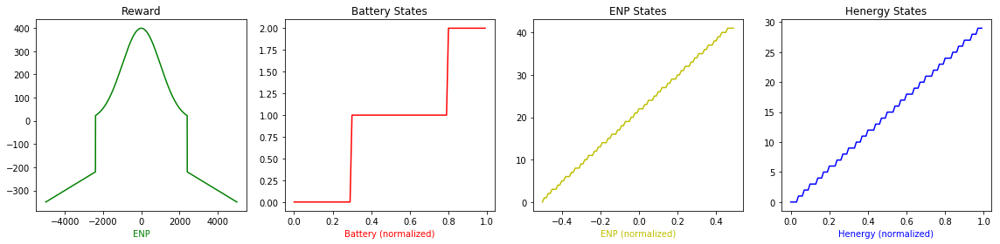

In [7]:
#Check reward function
#ENP varies from -0.5 to 0.5
y1 = np.empty(1)
for x in np.arange(-5000,5000):
    eno.enp = x
    y1 = np.append(y1,eno.rewardfn())
y1 = np.delete(y1, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#Battery value varies from 0 to 1
y2 = np.empty(1)
for x in np.arange(0,1,0.01):
    temp = sarsa.get_batt_state(x)
    y2 = np.append(y2,temp)
y2 = np.delete(y2, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#ENP value varies from -0.5 to 0.5
#Inconsistent with the reward function 
y3 = np.empty(1)
for x in np.arange(-0.5,0.5,0.01):
    temp = sarsa.get_enp_state(x)
    y3 = np.append(y3,temp)
y3 = np.delete(y3, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#henergy value varies from 0 to 1
y4 = np.empty(1)
for x in np.arange(0,1,0.01):
    temp = sarsa.get_henergy_state(x)
    y4 = np.append(y4,temp)
y4 = np.delete(y4, 0, 0) #remove the first row which is garbage


####################################
##   PRINT FIGURES##################
fig = plt.figure(figsize=(16,4))

ax1 = fig.add_subplot(1,4,1)
ax1.set_title("Reward")
ax1.set_xlabel("ENP",color='g')
ax1.plot(np.arange(-5000,5000),y1,'g')

ax2 = fig.add_subplot(1,4,2)
ax2.set_title("Battery States")
ax2.set_xlabel("Battery (normalized)",color='r')
ax2.plot(np.arange(0,1,0.01),y2,'r')

ax3 = fig.add_subplot(1,4,3)
ax3.set_title("ENP States")
ax3.set_xlabel("ENP (normalized)",color='y')
ax3.plot(np.arange(-0.5,0.5,0.01),y3,'y')

ax4 = fig.add_subplot(1,4,4)
ax4.set_title("Henergy States")
ax4.set_xlabel("Henergy (normalized)",color='b')
ax4.plot(np.arange(0,1,0.01),y4,'b')

fig.tight_layout()
plt.show()


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -175.15176133105365


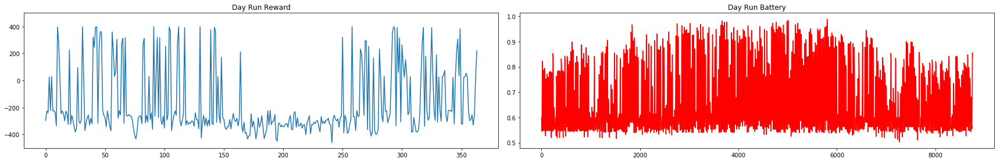


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -80.10897006187628


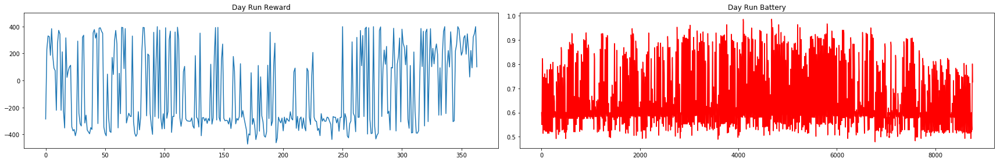


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -153.4059872166317


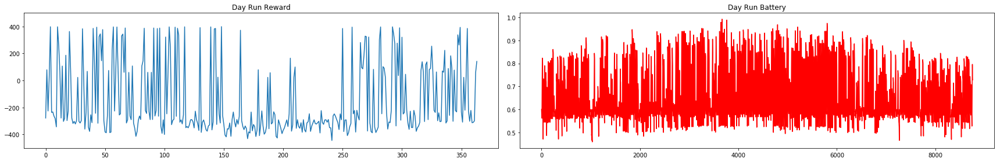


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  0.022581672122859154


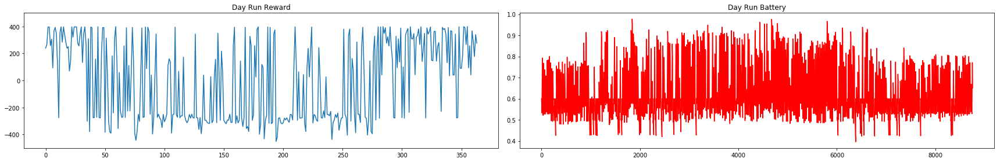


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  2.2931058193720233


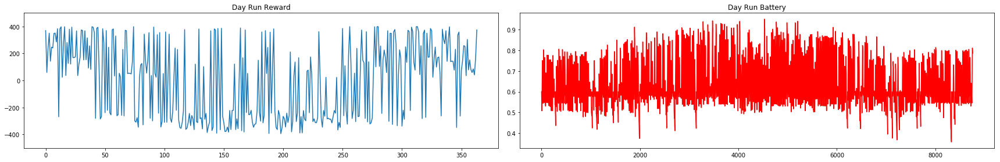


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -47.98595066478082


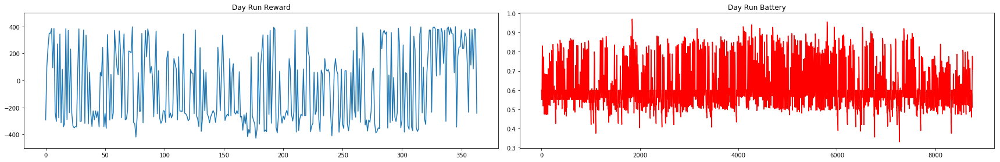


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -13.875093842662075


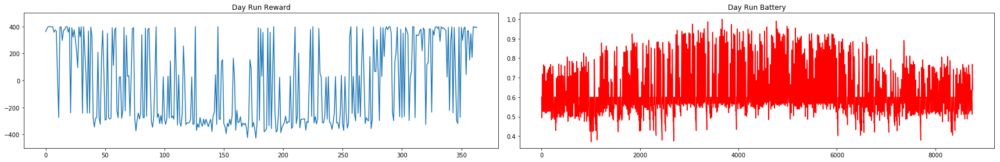


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  3.438278305359865


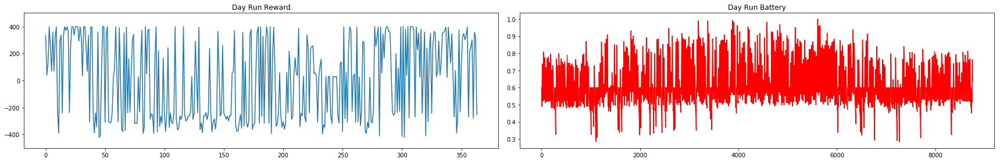


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  28.46790727848419


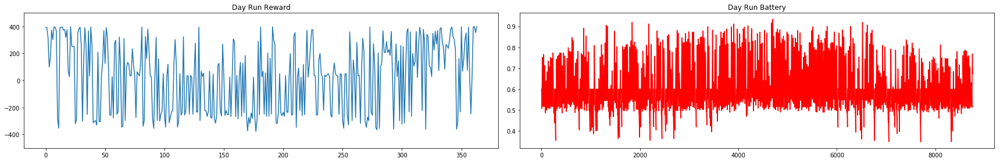


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  42.82592402299742


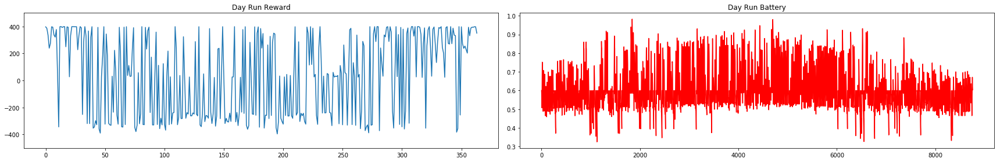


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  27.742234327769648


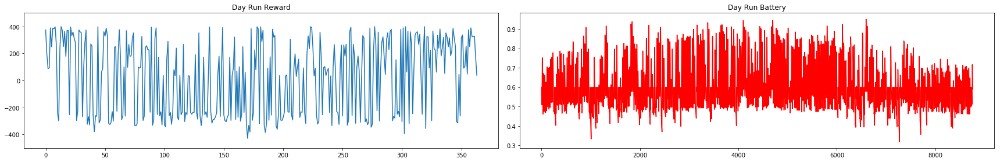


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  26.713317632452373


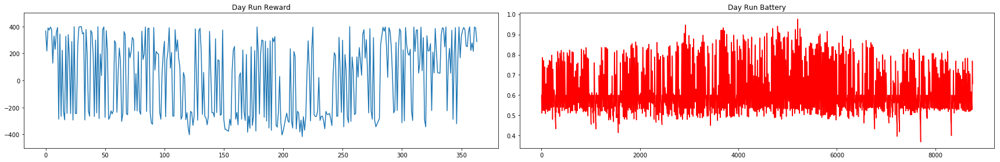


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  58.01092207733416


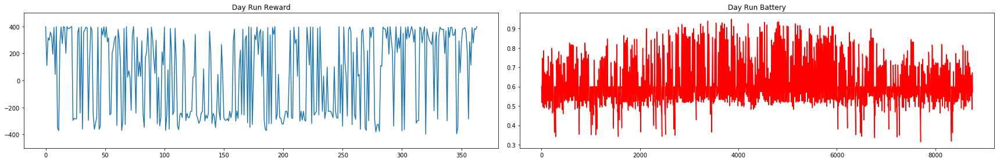


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  71.54159239115198


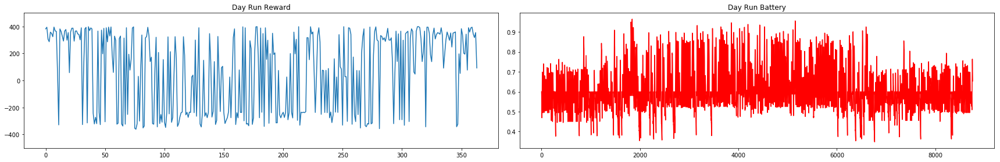


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  137.23698216226887


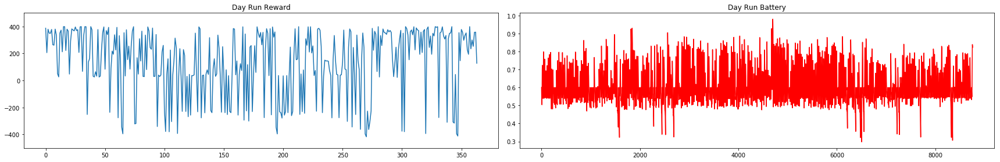


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  74.65627735999564


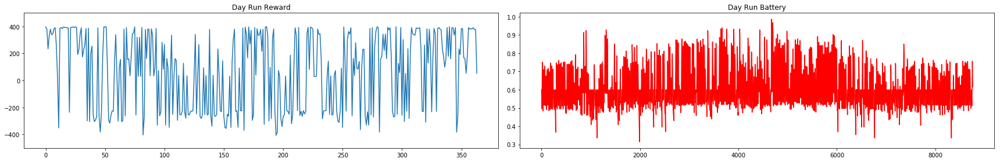


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  41.95945316951393


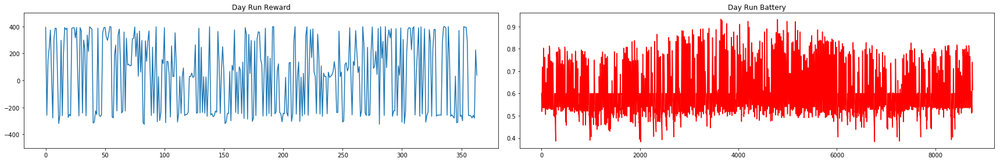


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  109.6514205117465


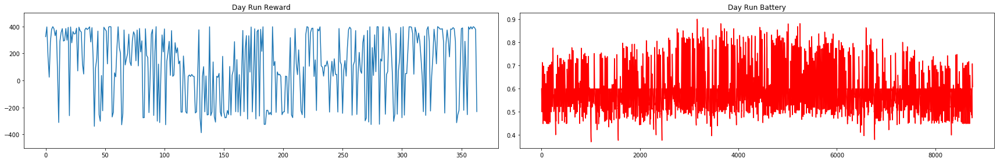


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  127.99602994711667


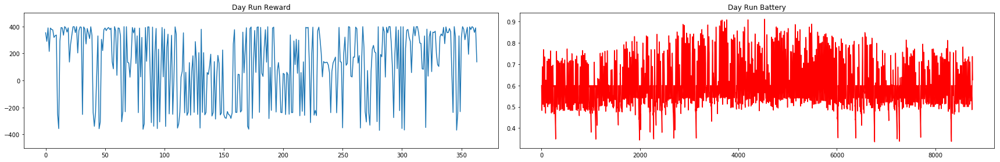


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  95.9487929933132


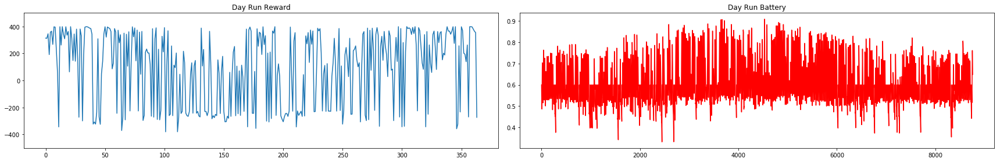


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  89.1744328124192


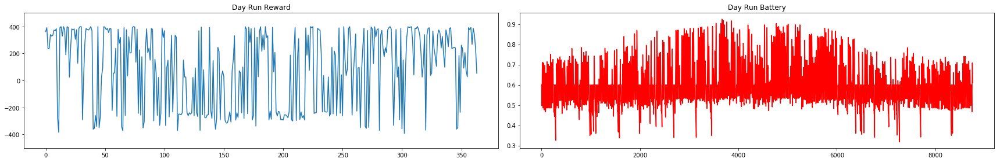


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  104.13615667898837


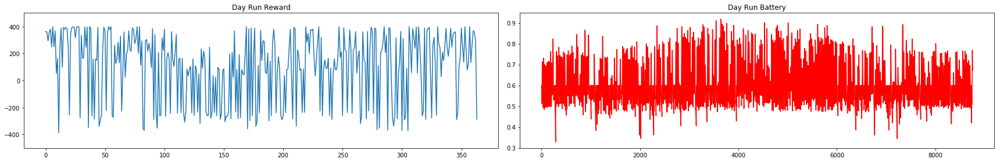


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  115.68898237166698


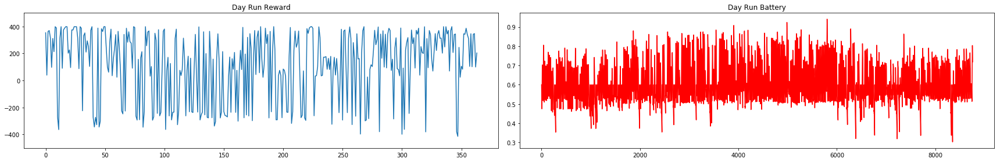


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  140.05637627579802


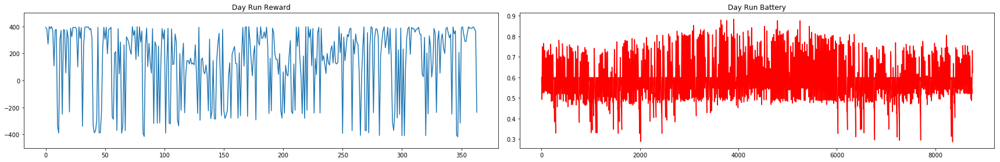


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  155.8345483061887


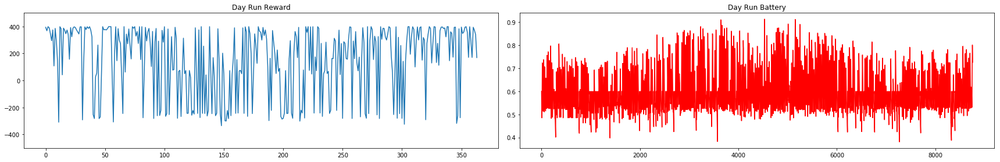


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  159.76110635365455


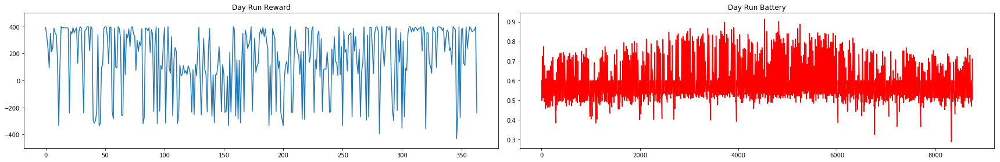


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.30488045752935


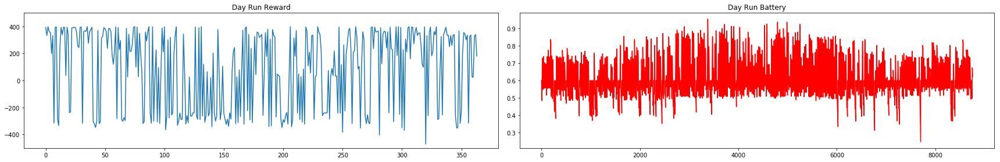


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  60.132189891338314


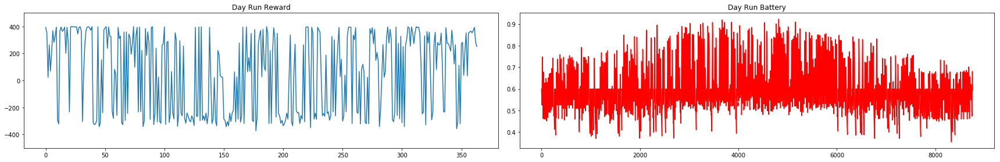


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  85.34467151368595


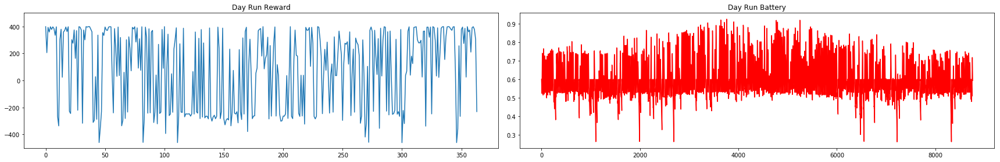


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  125.2950926102539


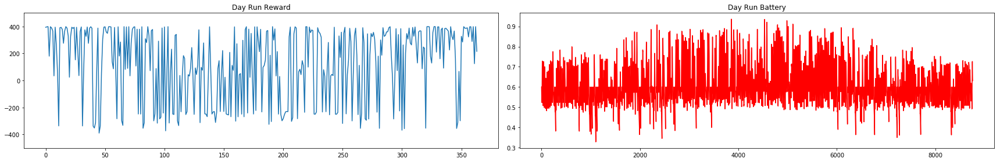


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  99.92609881987383


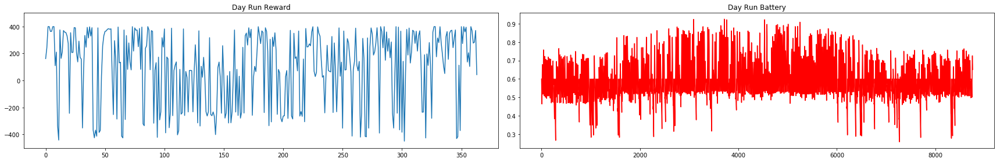


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  90.25946807966926


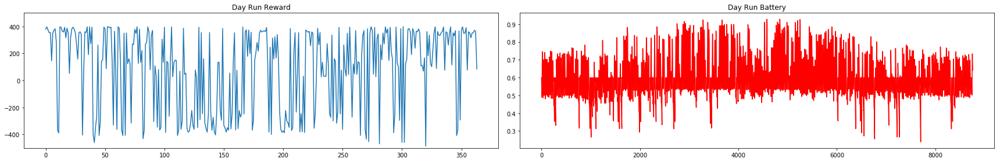


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  160.46558781406833


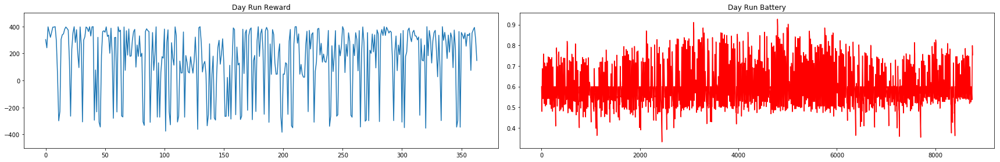


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  68.72990299303076


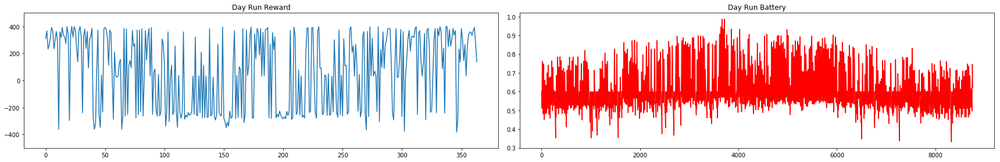


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  115.218980376087


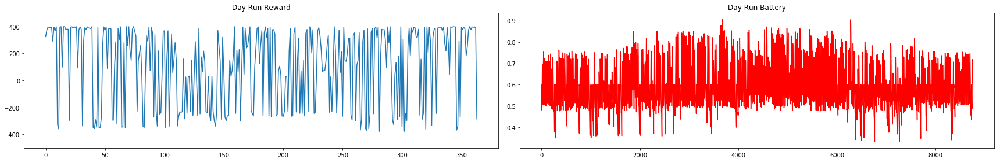


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  68.99836306940468


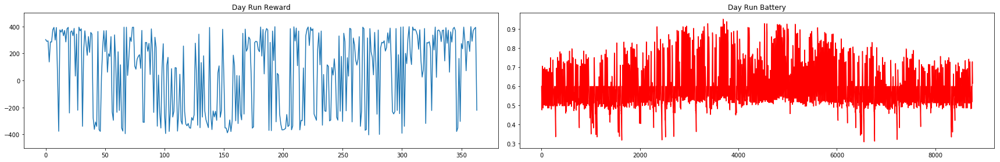


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  65.95611324283217


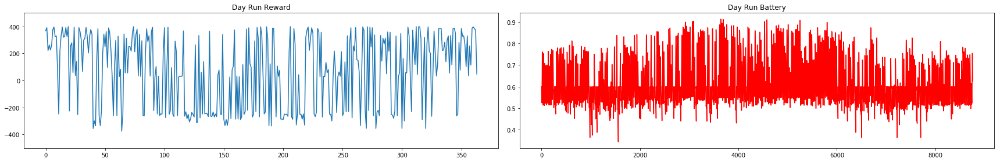


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  112.80820832840328


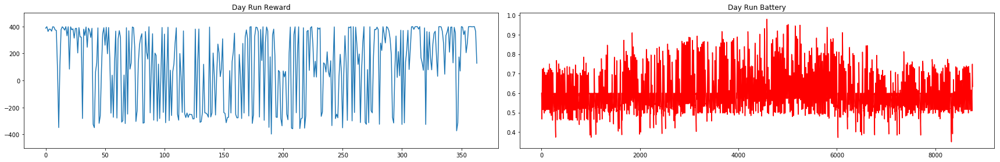


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  131.55418637968262


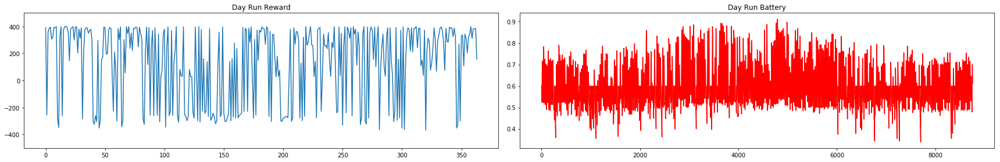


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  101.3632536813215


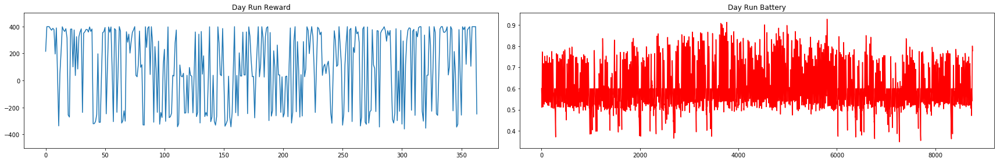


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  21.72660823673995


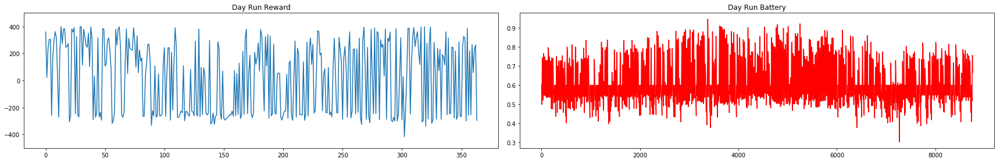


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  167.27667773990112


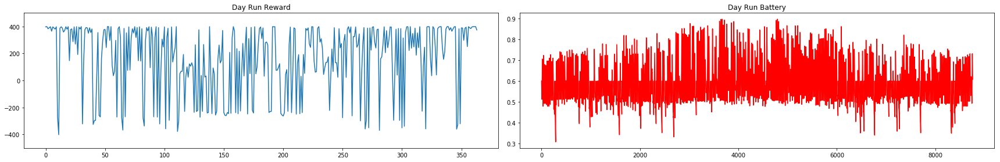


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  28.471861183747922


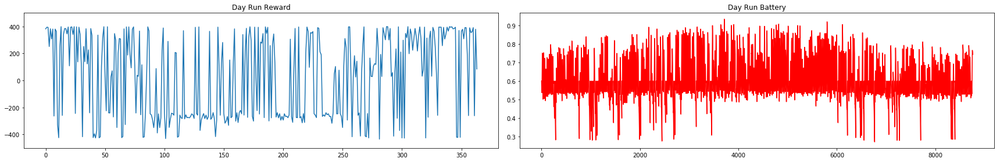


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  123.4420430695627


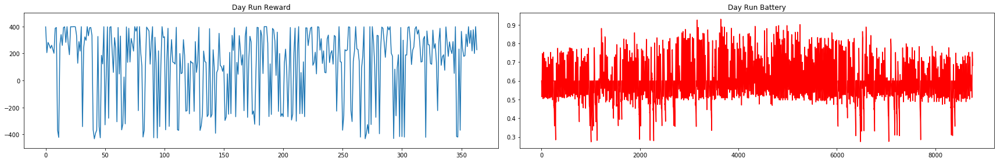


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  123.8675519267143


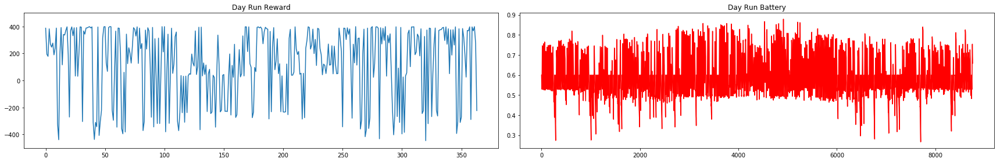


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  92.45276844795897


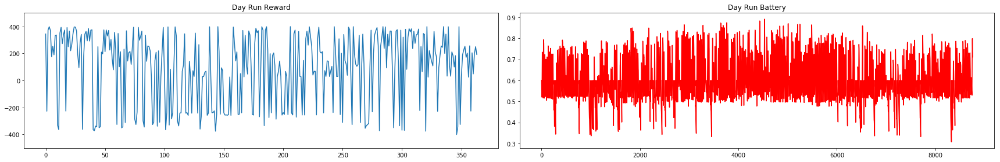


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  139.50532378682016


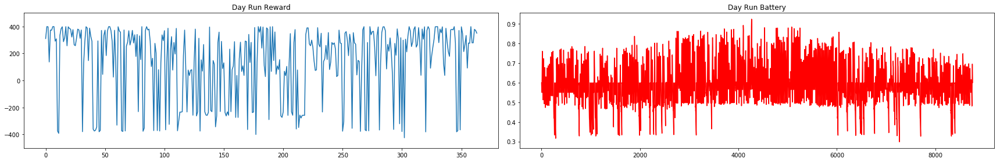


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  114.14812856871876


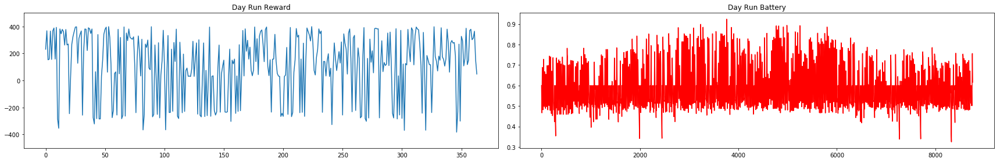


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  72.74801007589983


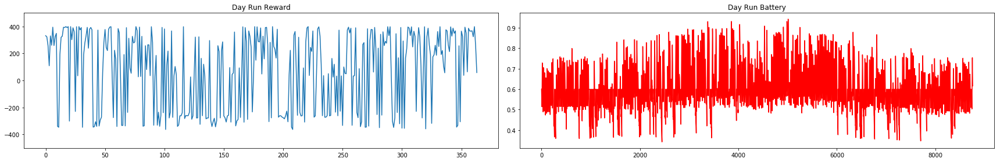


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  108.49359462205554


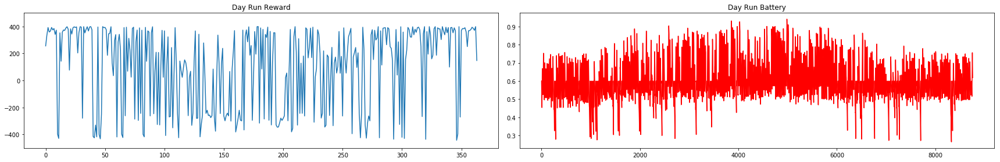


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  87.3904709715708


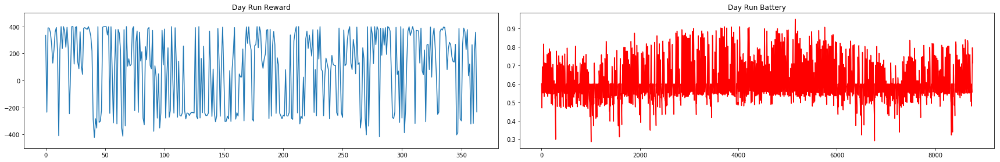


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  137.05699127917893


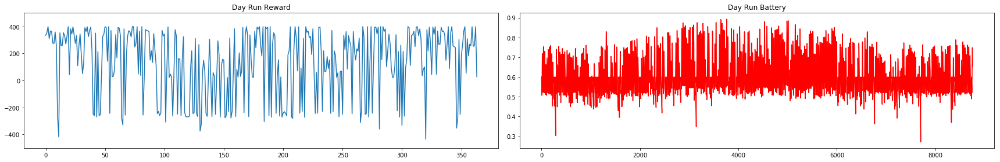


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  114.40898024219388


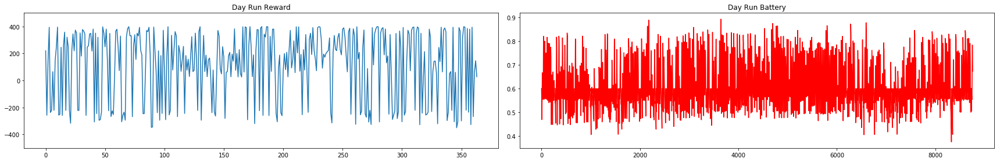


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  78.2193943993345


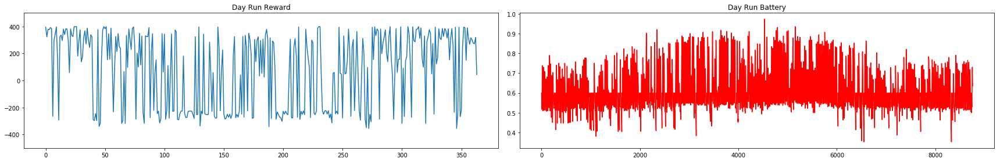


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  211.3455411005165


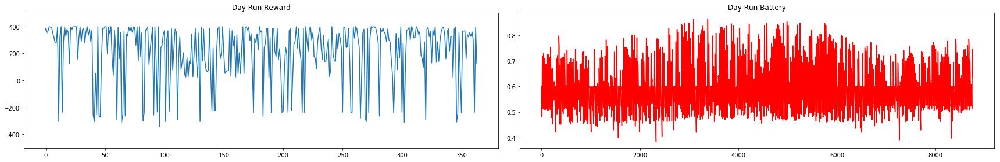


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  162.5122485711588


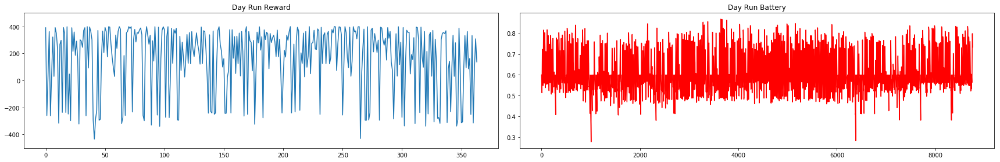


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  167.12105895867236


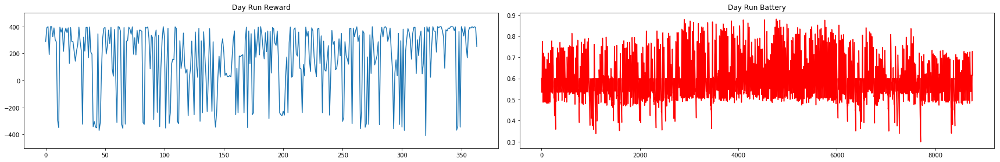


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  209.48959893445175


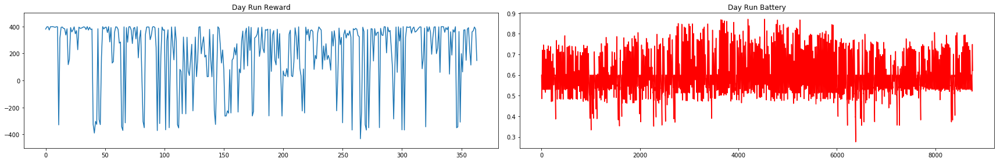


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  194.89544524093378


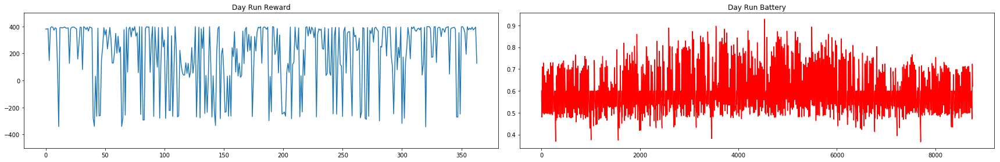


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  230.55371452284345


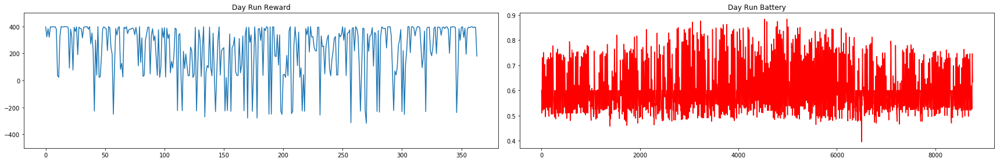


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  201.82871893180658


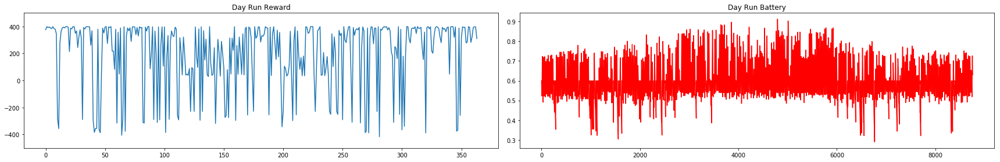


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  88.35539589223276


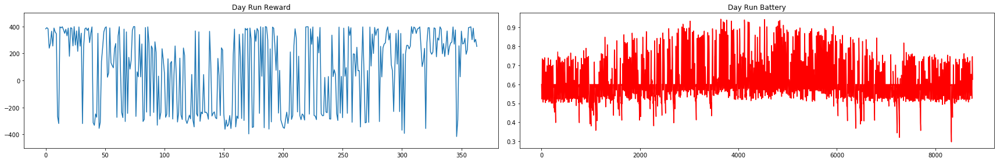


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  126.20114214822635


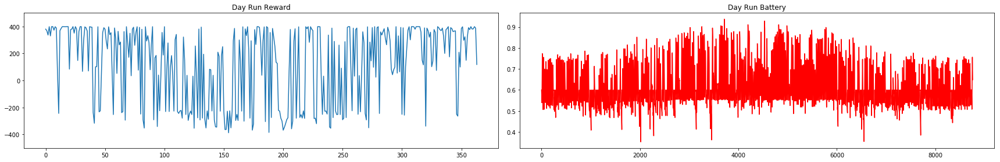


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  172.00828156508783


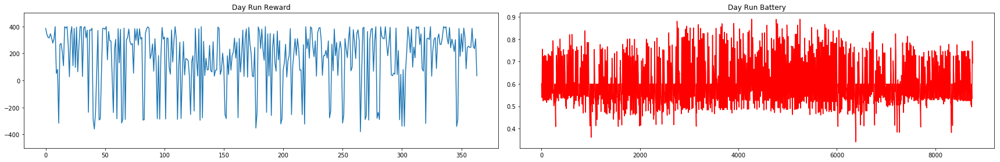


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  185.9213939840433


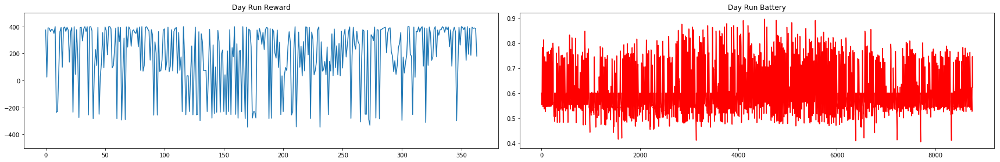


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  151.91282506067768


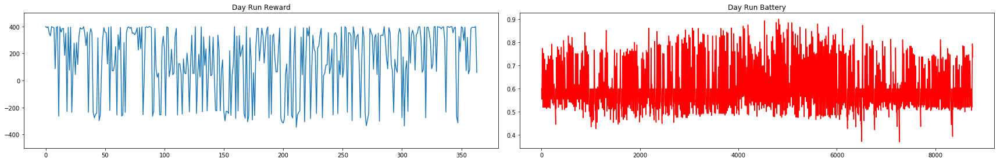


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  192.73011115519907


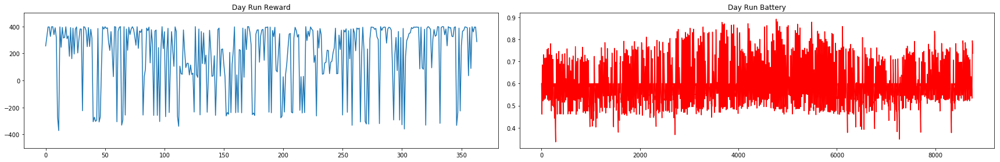


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  226.36258078054607


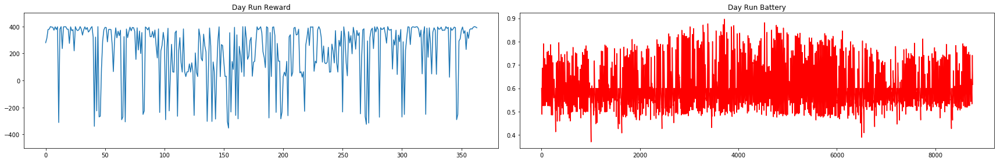


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  223.71887199443879


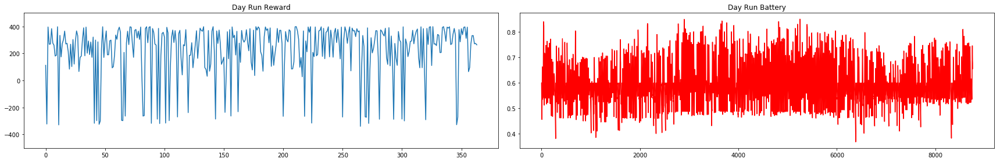


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.9574382282365


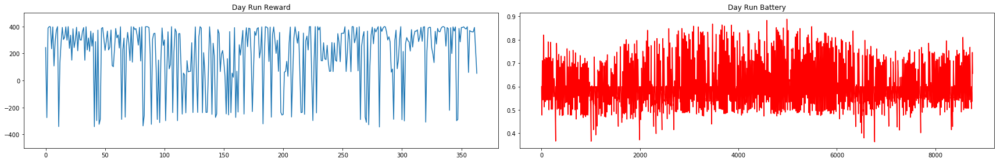


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.66249188658853


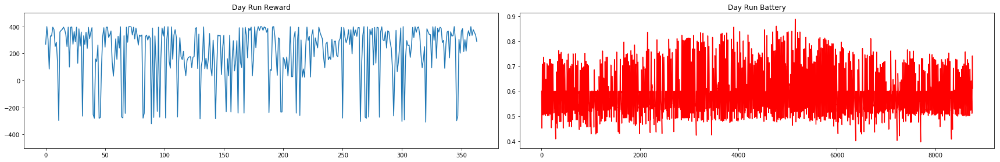


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  125.10424114479103


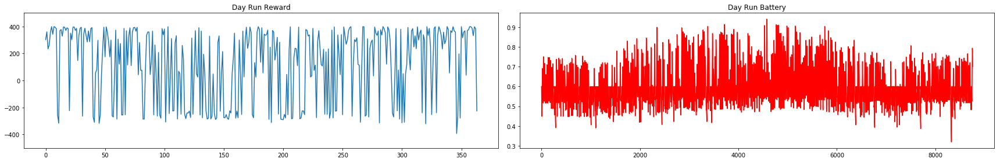


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  170.9606732704764


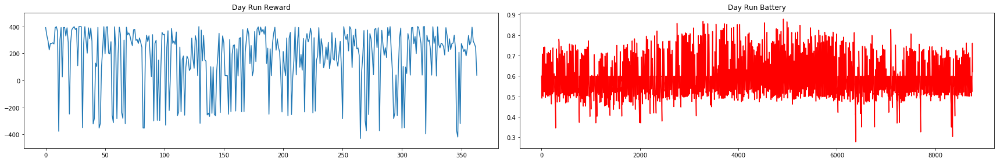


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  181.0137535196459


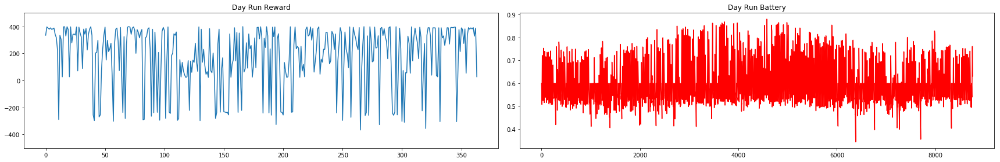


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  210.40329070118366


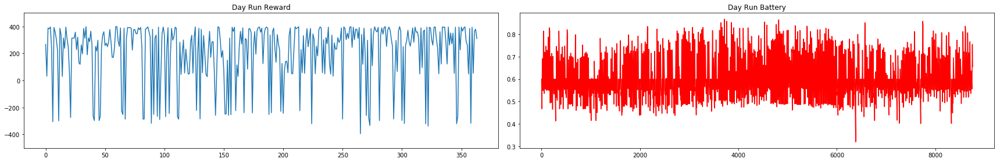


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  164.44478429109915


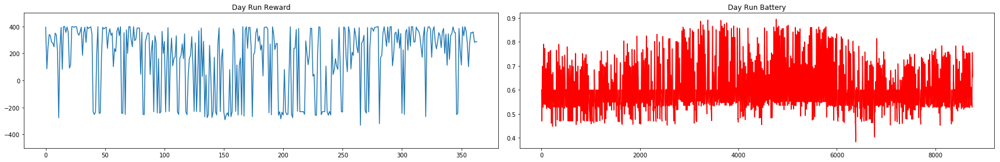


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  209.92467333683612


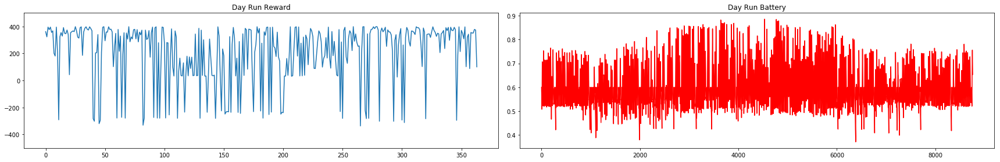


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  195.7368549780556


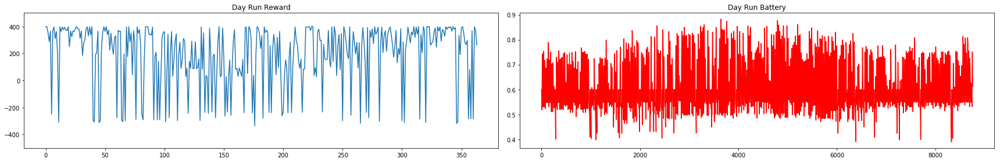


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  202.69728586404517


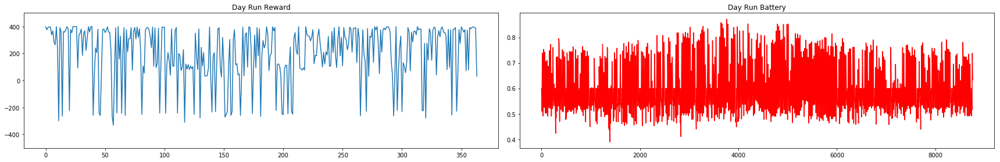


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  134.53981602322025


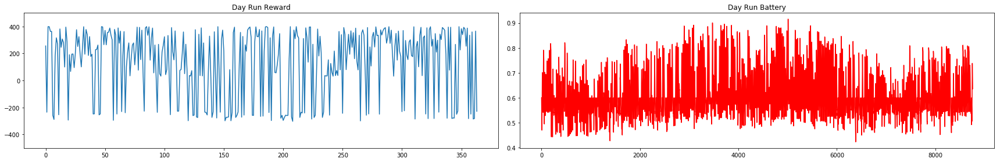


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  155.10221273490495


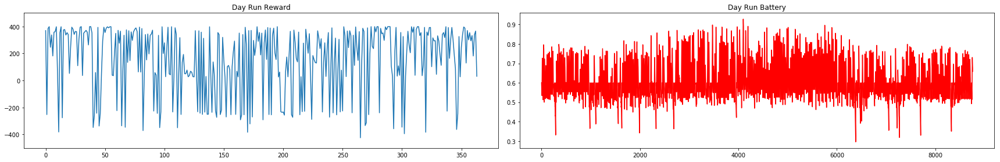


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  156.56996248741982


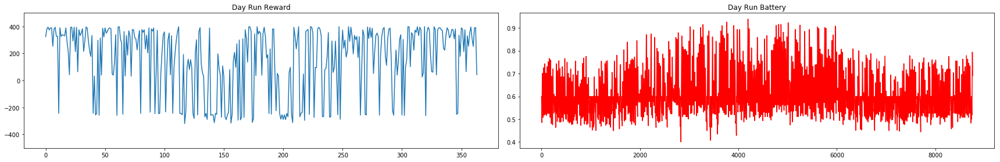


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  258.7328137875045


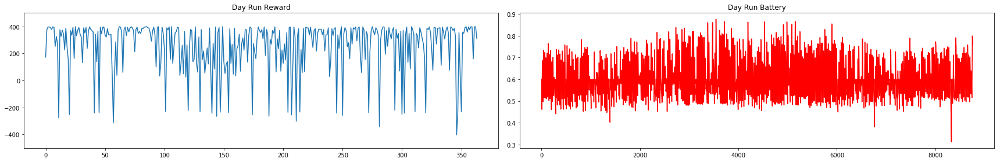


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  228.57246660778458


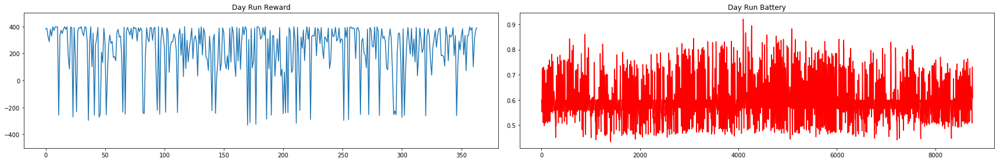


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  202.66169647324568


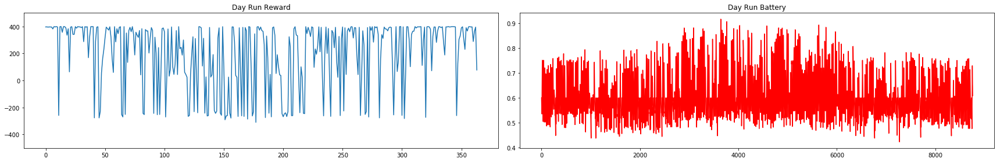


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  239.24333339375627


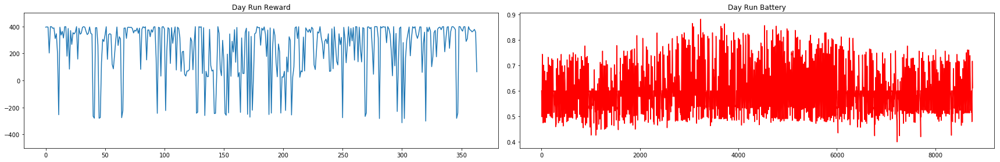


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  248.13630359189887


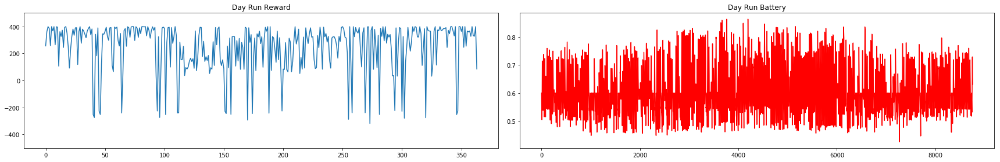


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  183.53639832554194


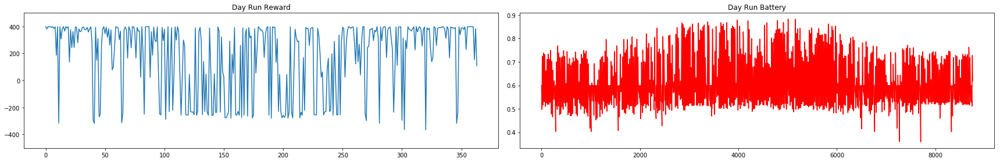


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  182.51589943116878


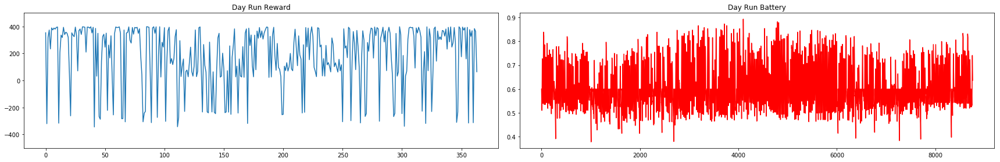


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  219.033955197095


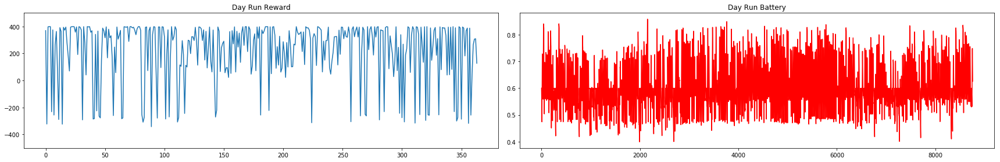


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  239.47590342973135


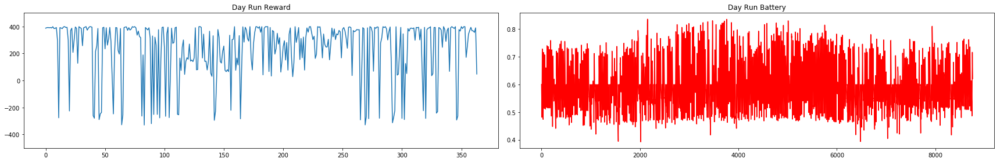


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  284.6487485150198


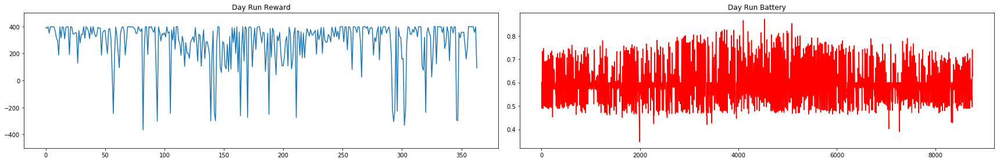


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  270.4722547113293


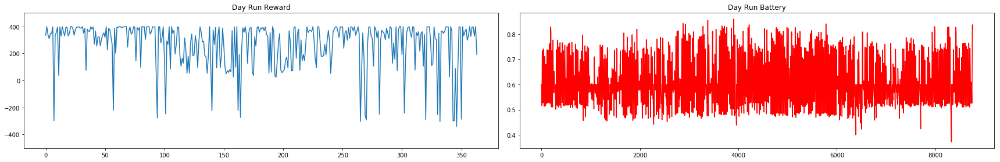


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  199.07425495611054


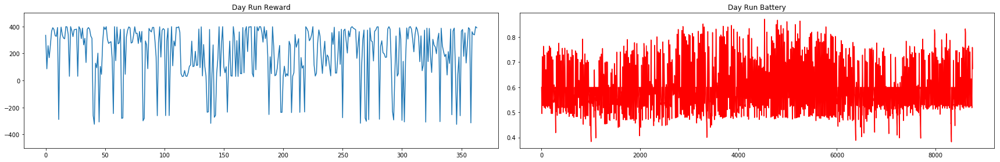


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  186.83533938895465


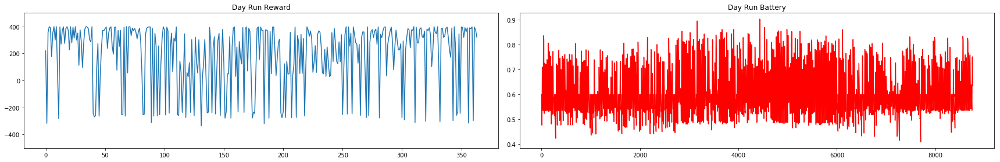


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  223.93179927593954


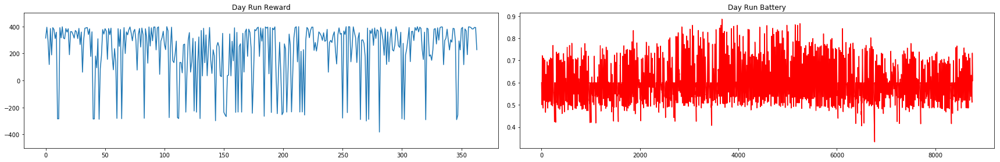


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  246.28619433873445


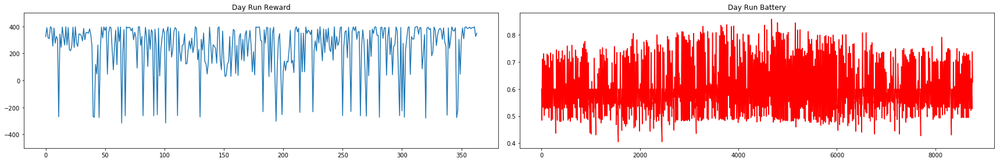


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  259.4426185117974


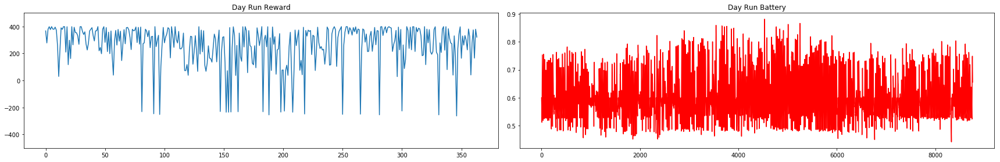


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  211.94244884371872


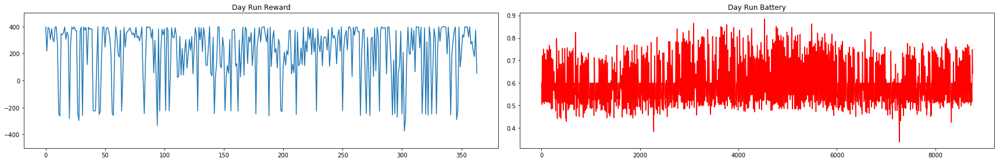


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  147.42697188599578


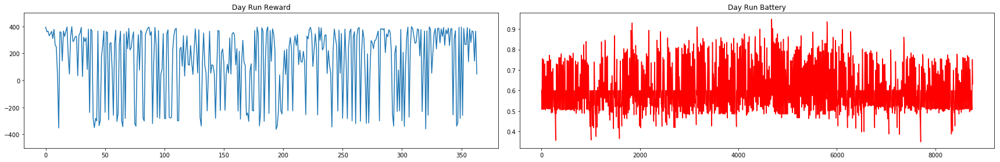


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  144.9355047634882


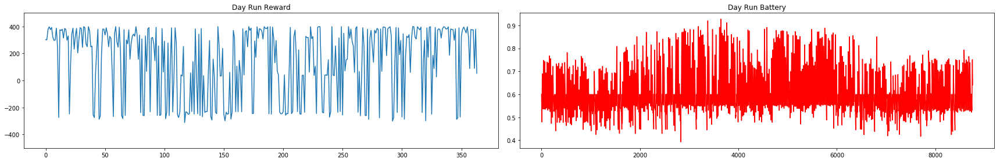


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  227.43014276541115


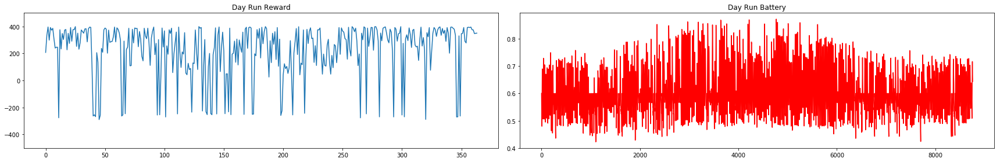


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  193.23447381493187


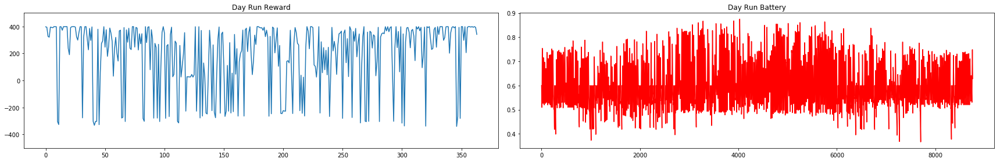


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.22917648018034


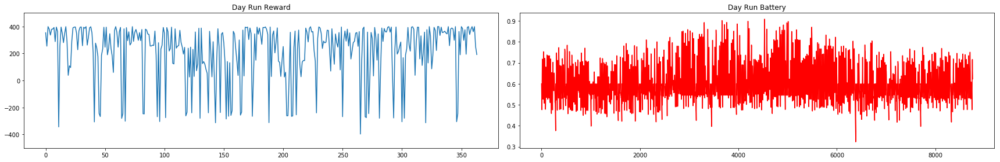


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  149.25546638203835


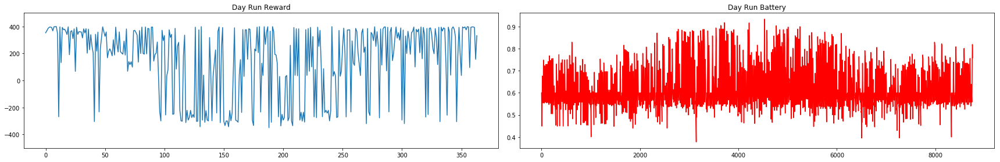


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  216.4864179955478


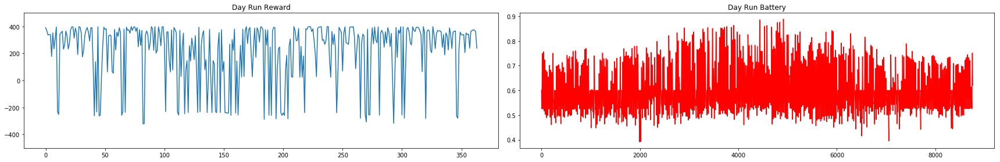


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  222.52477464455885


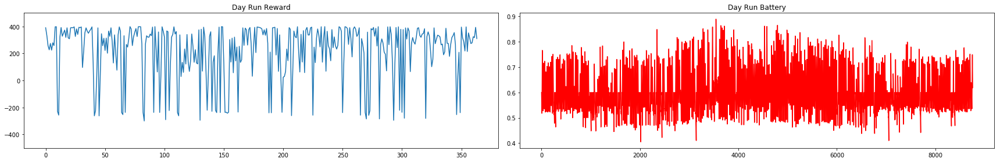


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  205.59171463896033


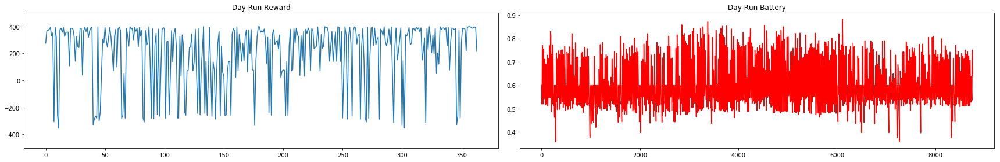


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  234.054290509508


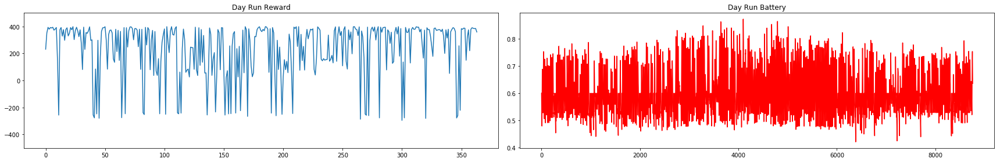


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  207.33431224524534


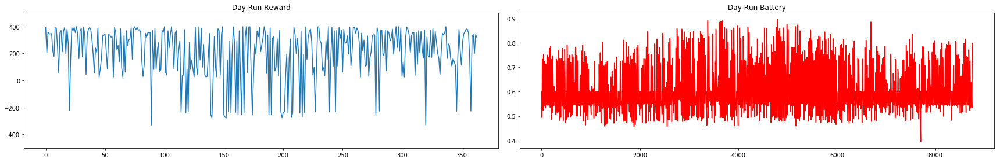


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  200.21258218870844


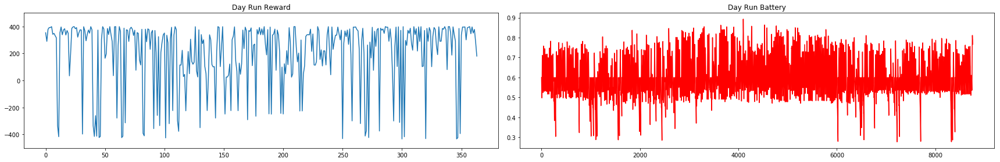


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  242.89472511356868


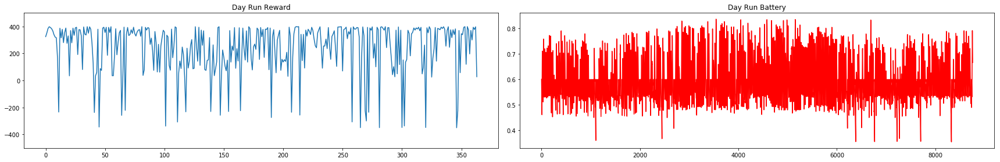


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  216.1983473072615


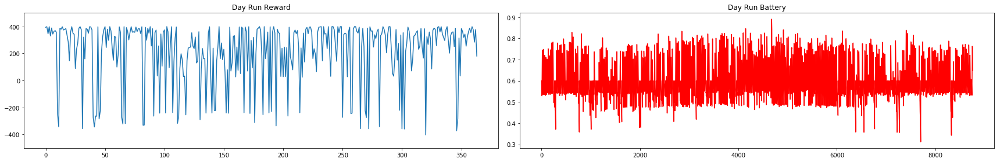


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.01603480616942


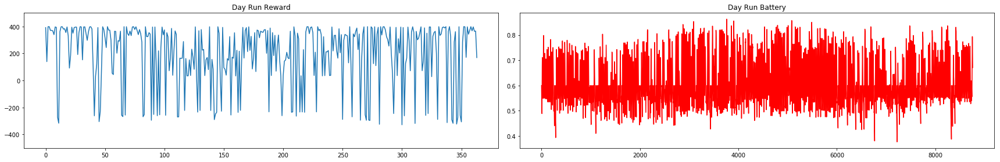


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  224.0491947783587


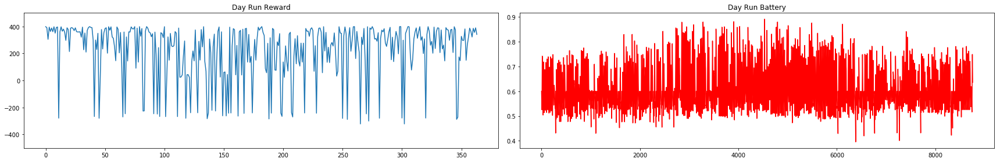


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  210.80430125308587


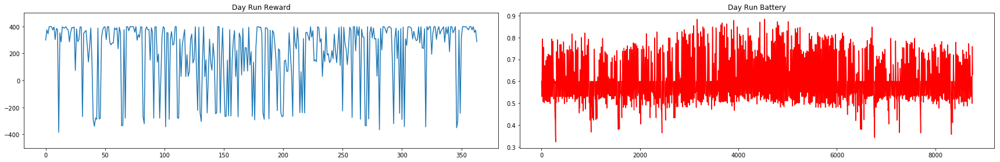


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  230.18680970604288


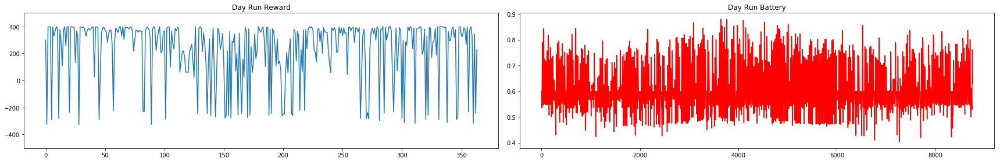


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  213.7196751674901


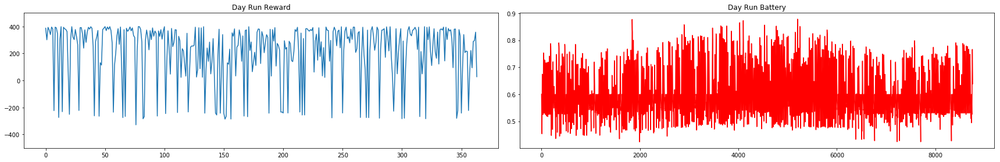


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  215.08049525467928


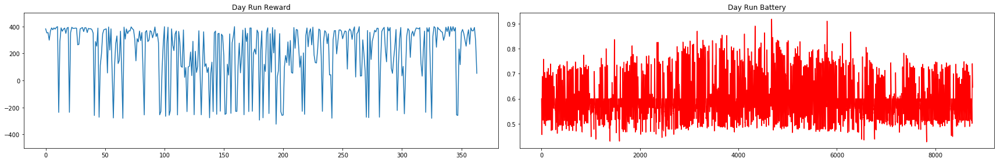


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  226.17051355124437


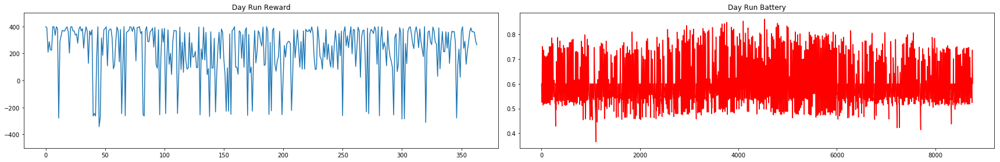


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  203.5271208993717


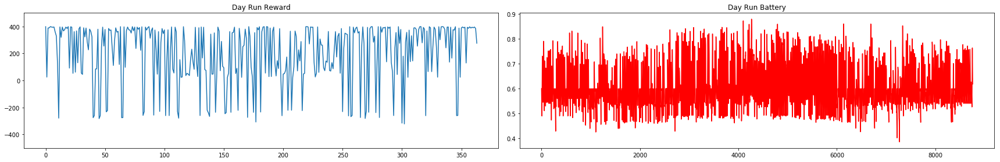


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  144.40515206750763


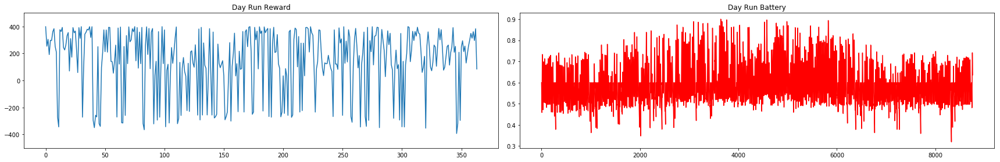


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  227.4894981220462


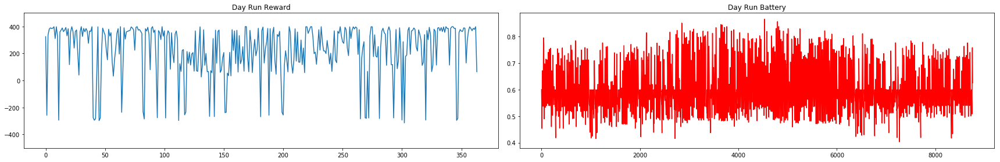


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  229.70182210273688


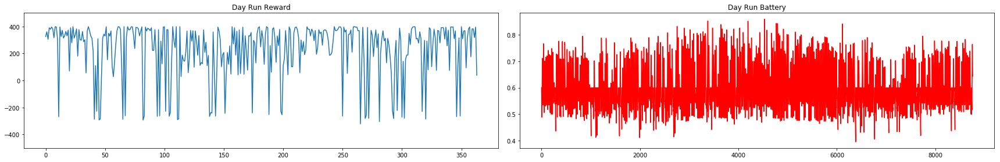


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  188.63743285765452


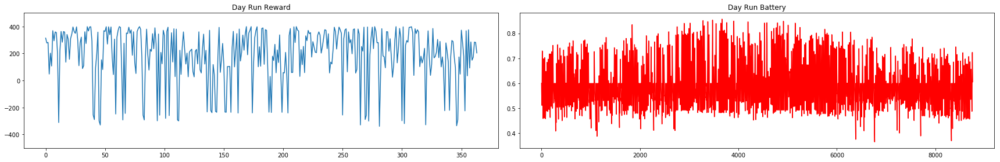


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  180.02253624364855


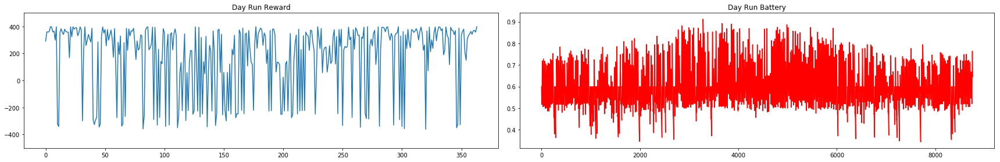


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  198.13959317989614


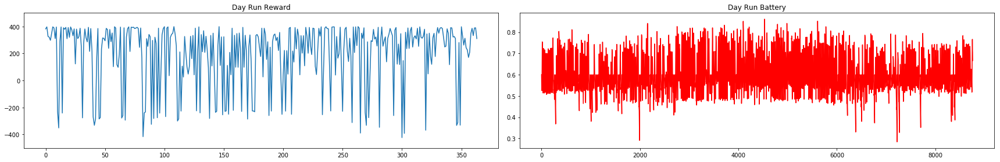


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  230.50783790212418


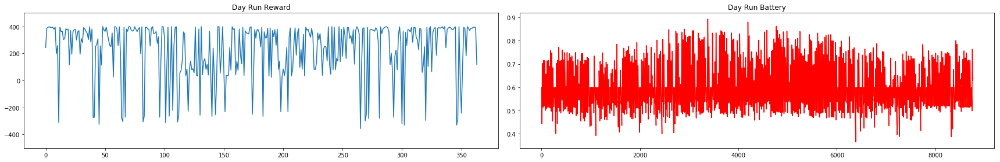


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  237.86202259060792


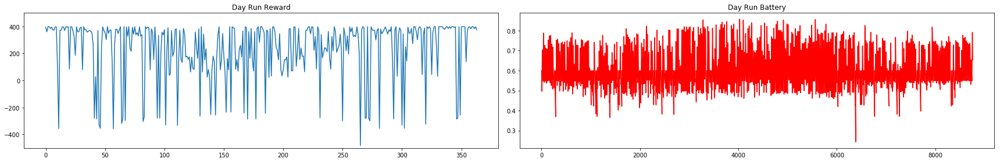


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  185.64670522196195


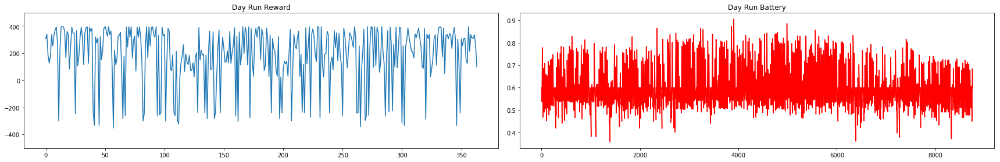


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  219.35627980484847


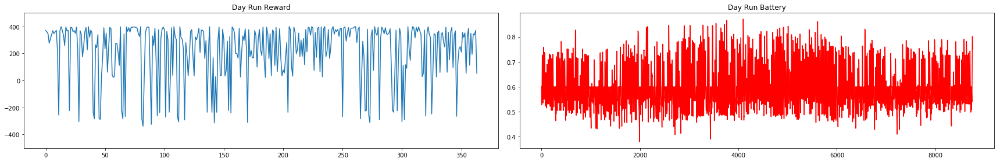


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  240.7127749037855


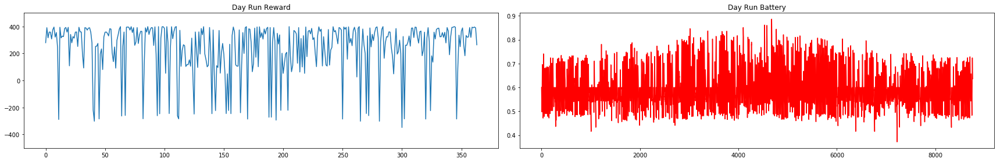


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  203.04270385017858


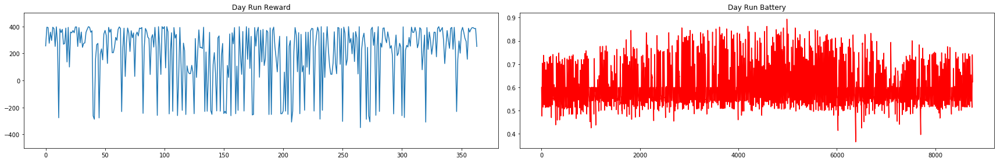


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  157.89963030900287


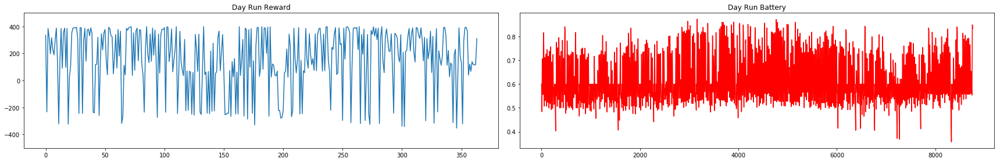


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  251.69482956318183


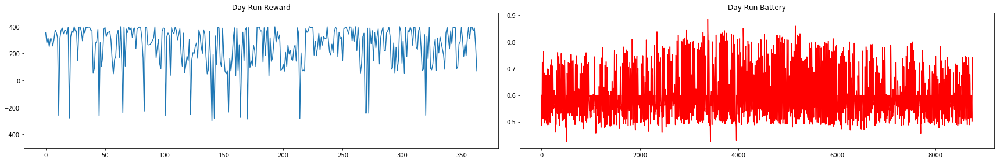


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  245.76765322990607


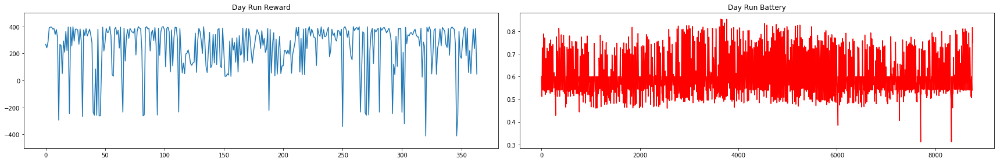


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  209.37150899131234


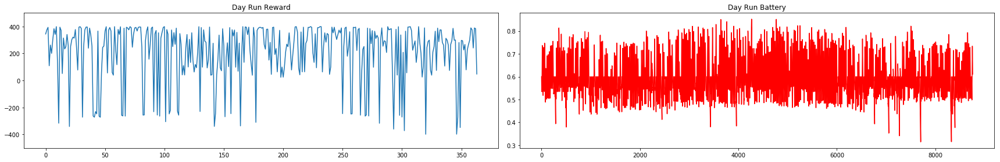


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  220.38494857347894


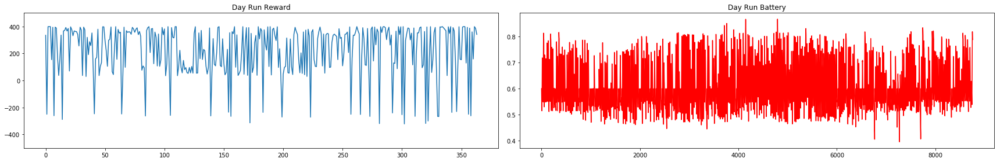


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  262.1440973232565


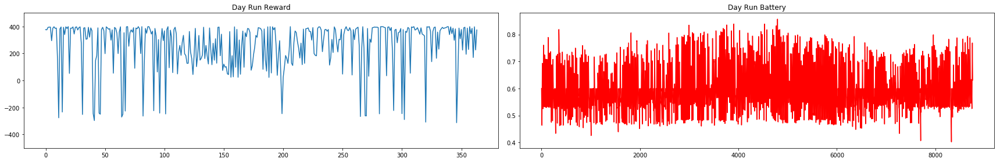


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  255.02281556353537


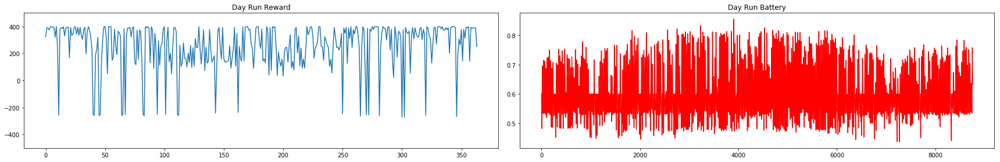


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  222.805512201007


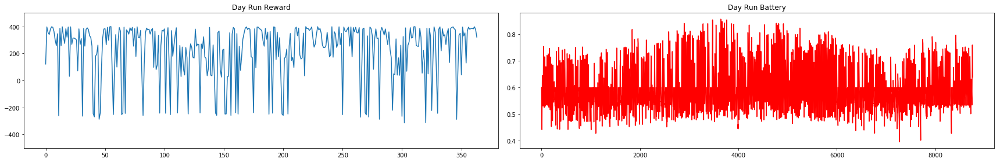


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  172.66191498727295


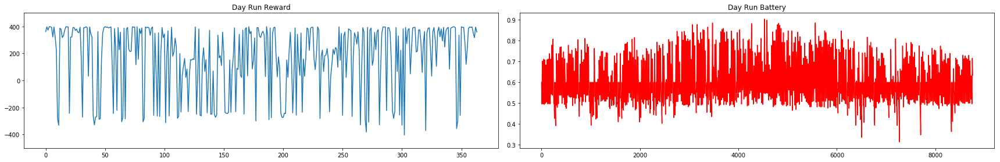


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  141.72595688403666


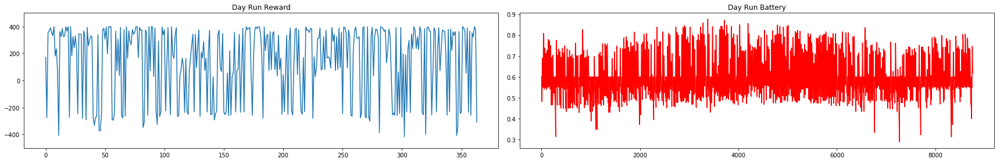


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  248.73654976528778


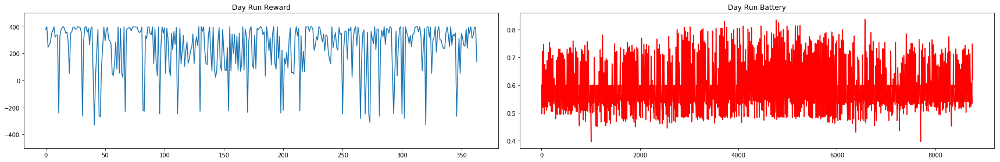


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  211.32679667388788


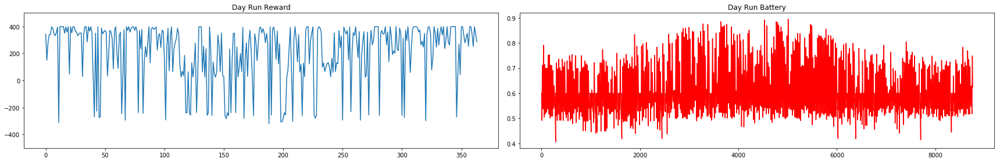


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  205.2109926589125


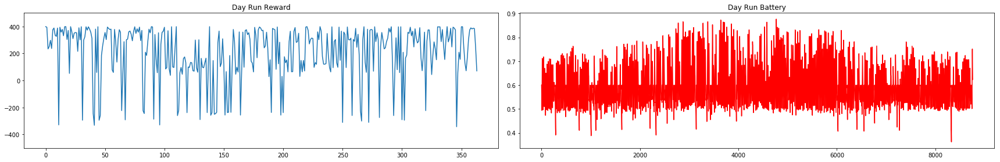


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  175.89322995358188


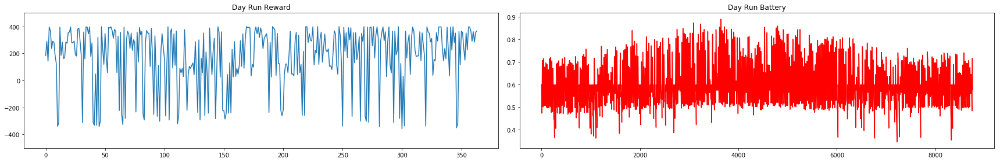


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  209.8009847057638


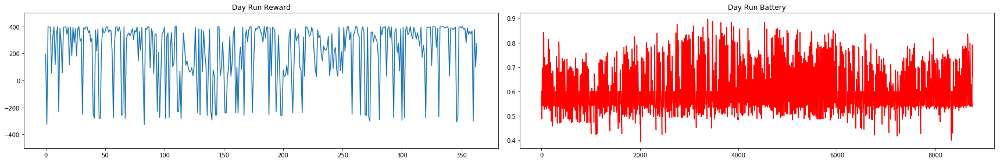


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  177.1194740438042


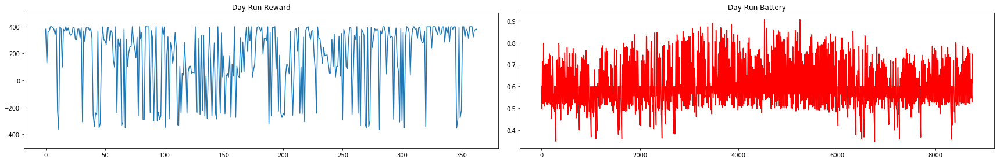


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  198.79905683225374


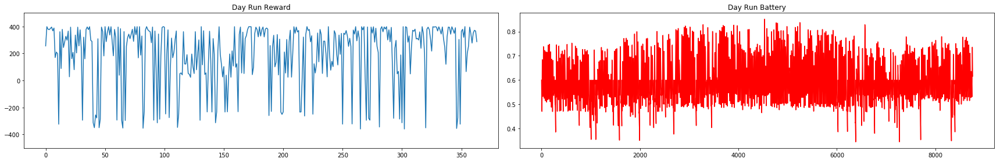


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  192.39997315323419


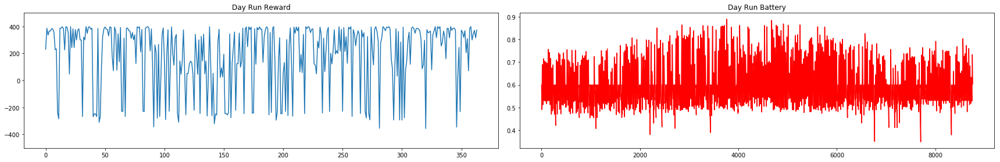


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  161.6665074648889


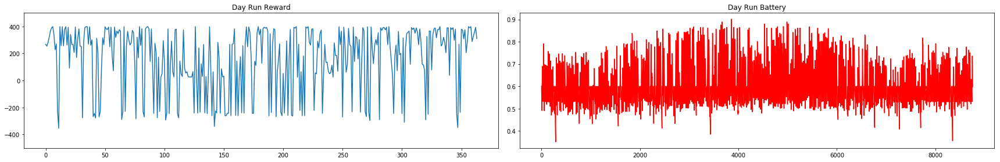


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  242.8221393663762


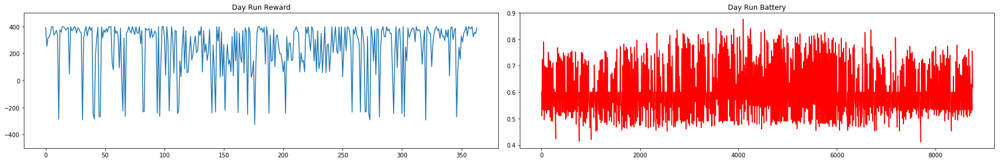


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  239.34952264884637


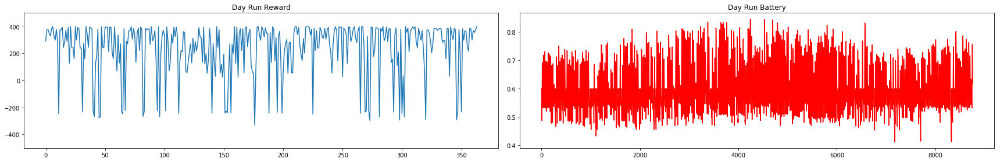


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  261.36910183998924


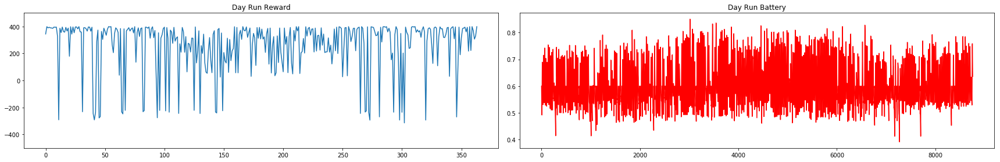


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  236.72621856811395


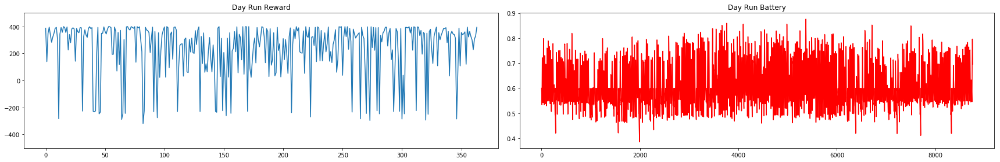


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  245.61159227620362


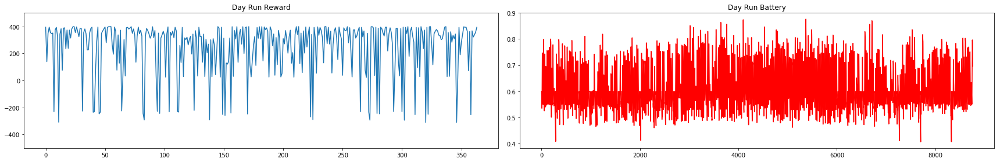


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  222.84665766151667


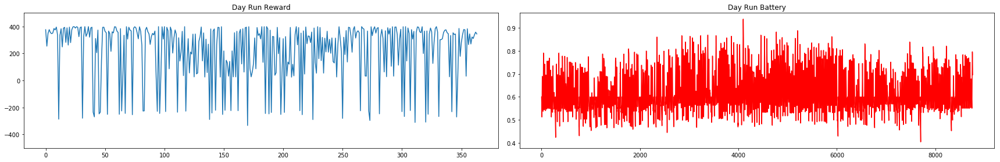


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  249.18277701909085


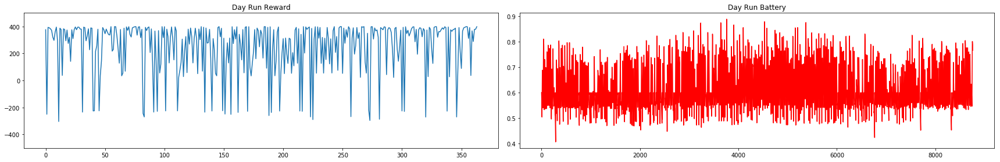


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  224.6462839989499


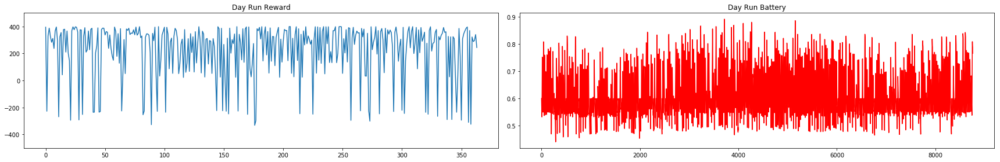


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  222.36991669948154


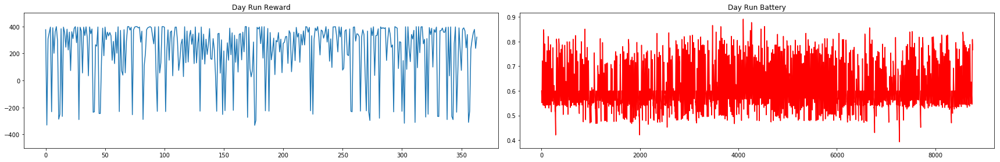


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  192.76761665482874


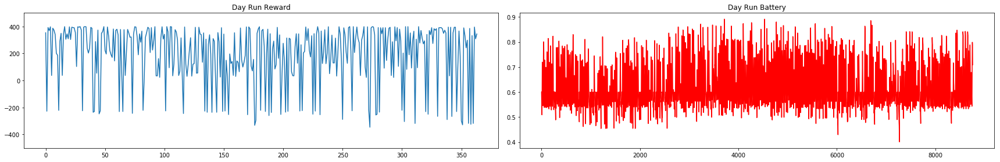


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  145.9913959644978


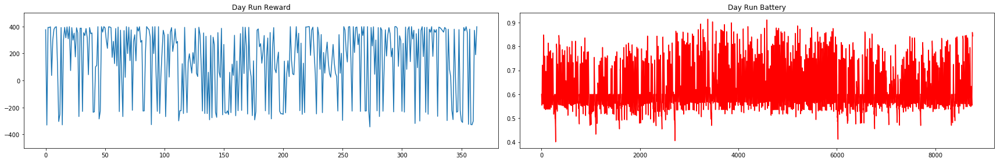


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  211.36777602478165


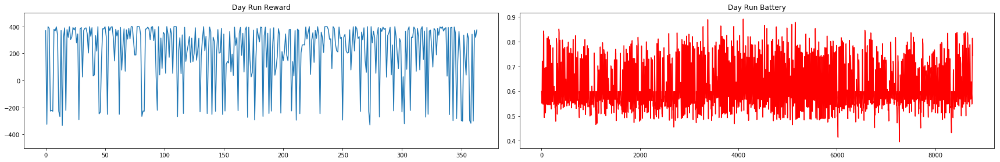


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  180.54709248884518


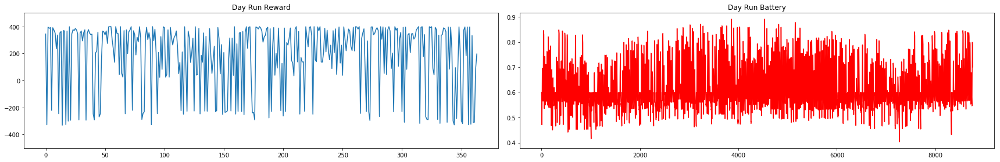


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  179.27555775907518


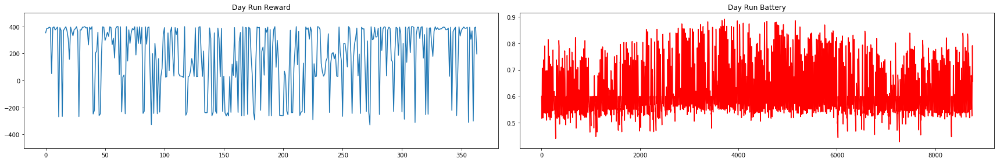


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  213.2529941345047


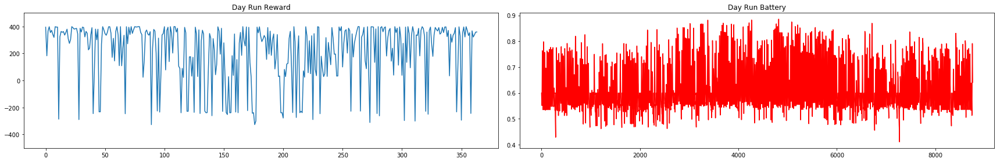


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  234.94162032339952


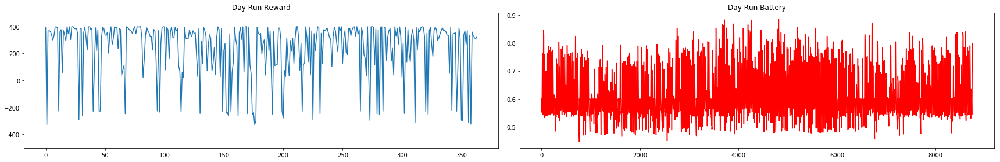


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  251.47282422533462


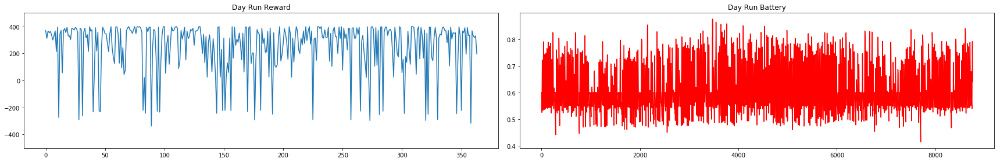


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  262.45504594627556


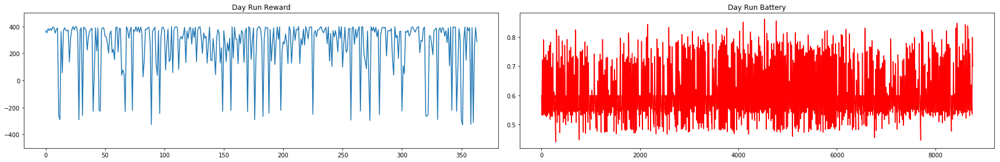


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  253.38443418864014


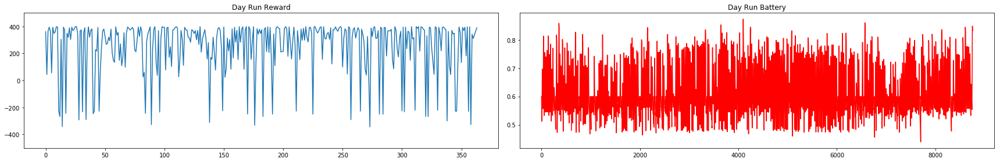


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  244.01422412527322


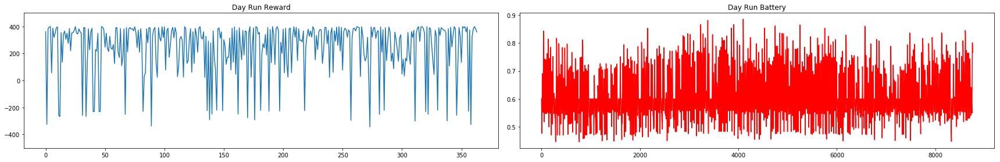


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  187.97168094169223


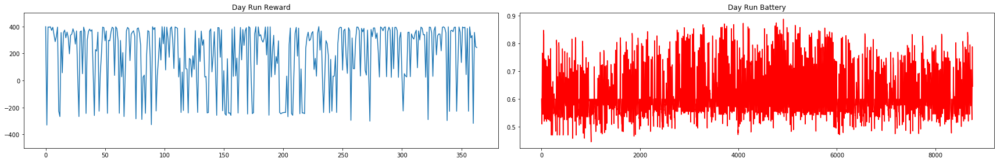


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  207.9996231298316


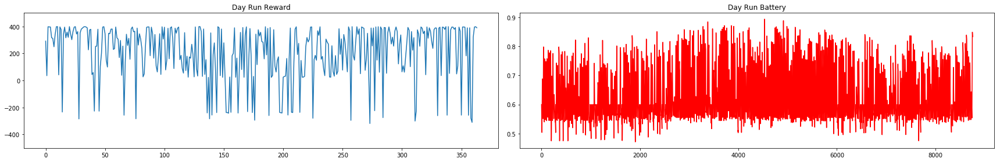


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  205.57668549956253


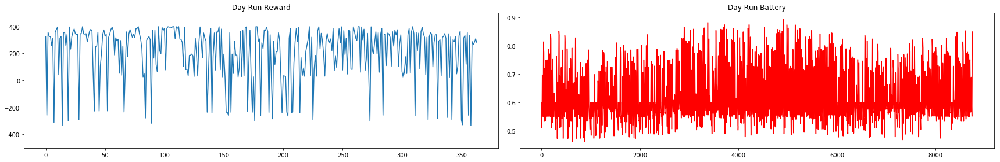


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  239.08837482732957


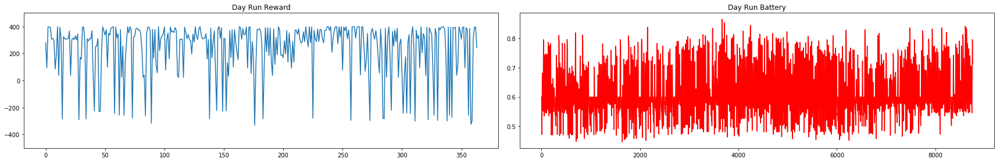


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  220.95333964421414


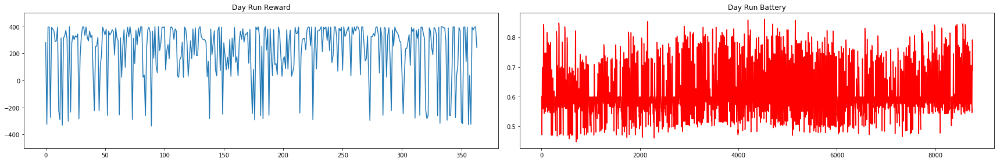


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  218.95469121683922


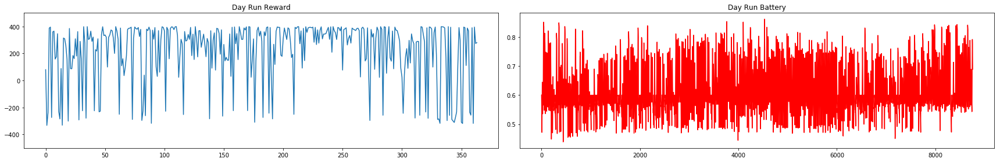


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  245.3452420135501


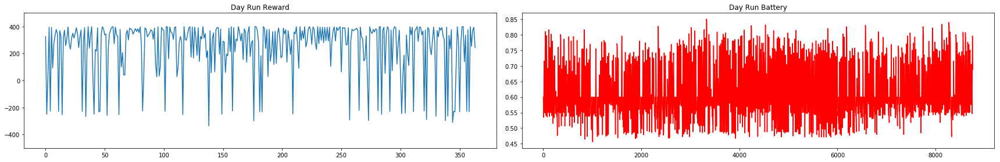


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  250.44570721132922


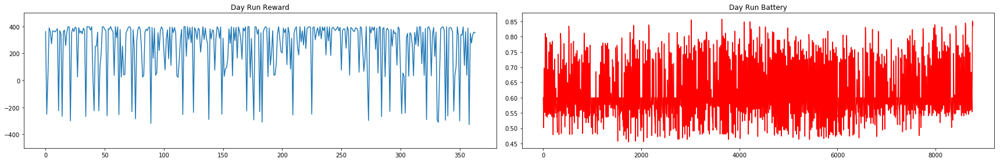


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  245.95269187075365


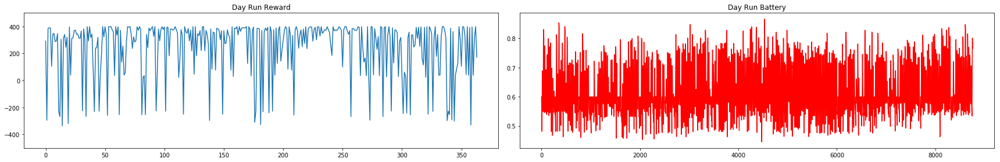


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  221.03847003419438


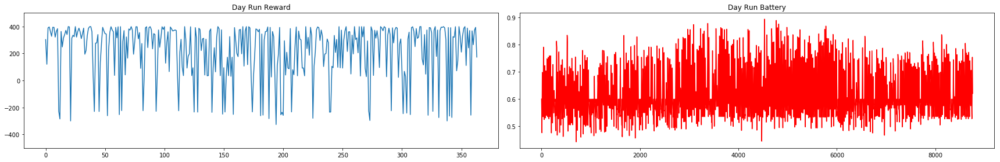


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  215.30673305377783


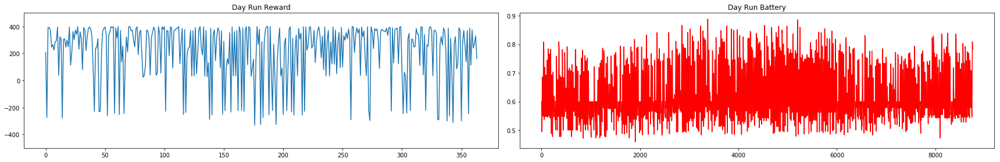


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  259.02343584305856


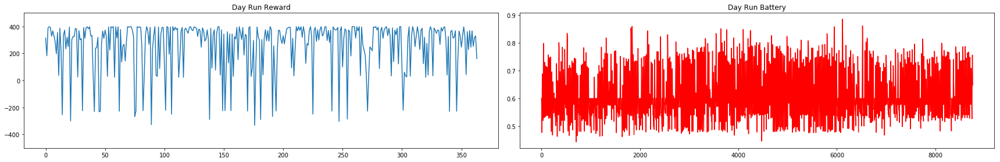


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  262.4109886892374


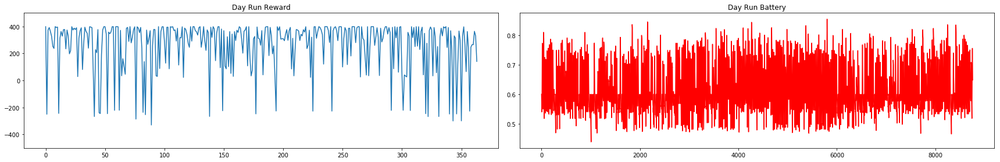


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  257.78002421753473


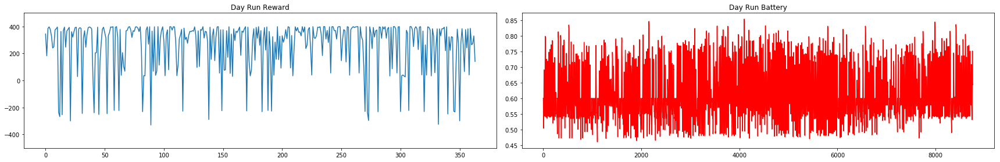


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  274.92270915834564


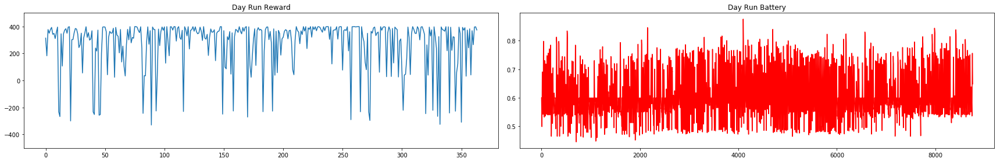


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  278.63953308358384


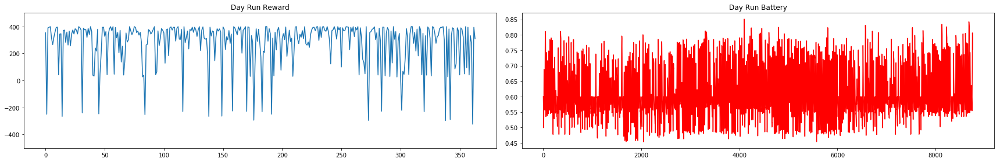


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  253.71937759417327


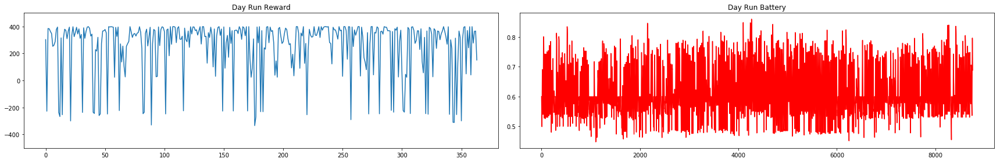


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  256.78878854990876


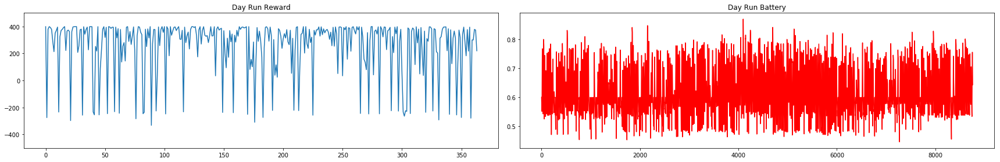


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  257.4504401238522


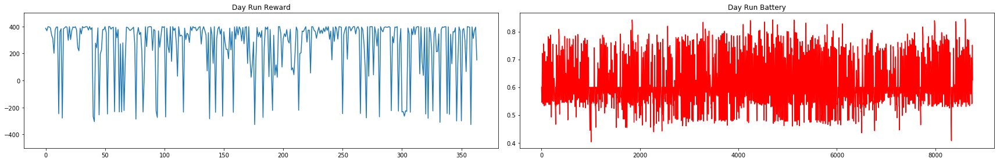


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  250.18107692167226


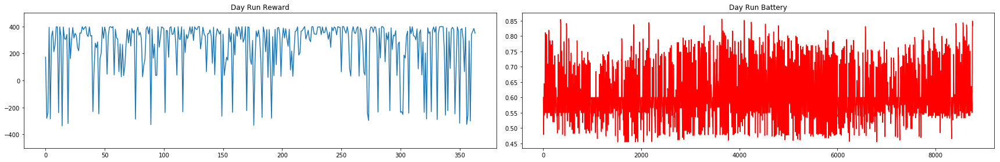


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  226.56026347896594


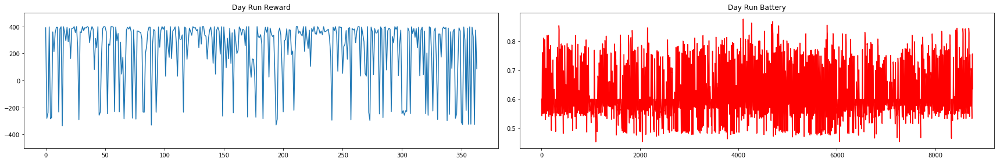


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  257.7338896235961


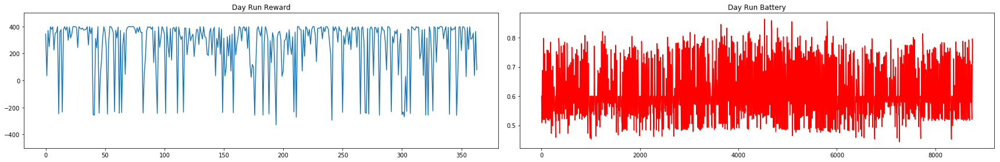


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  213.82717767084094


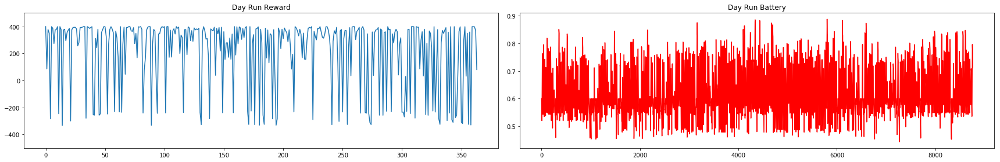


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  268.8141310043352


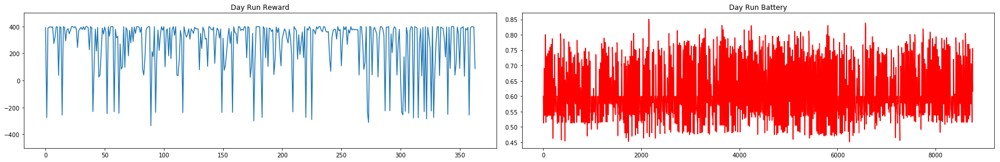


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  241.3052380554386


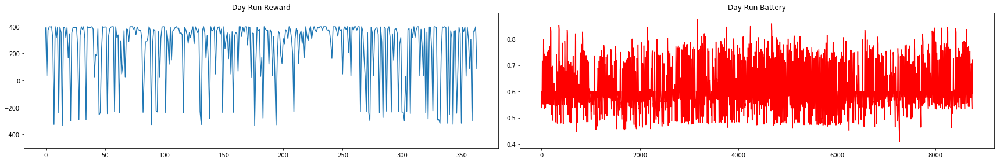


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  252.12560368306114


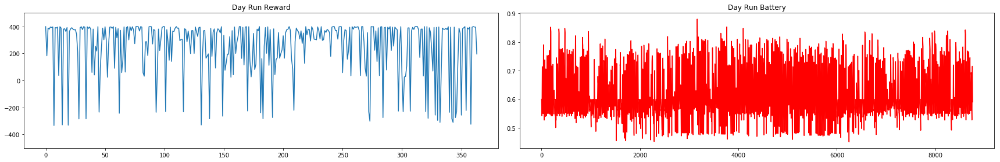


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  229.0752281804116


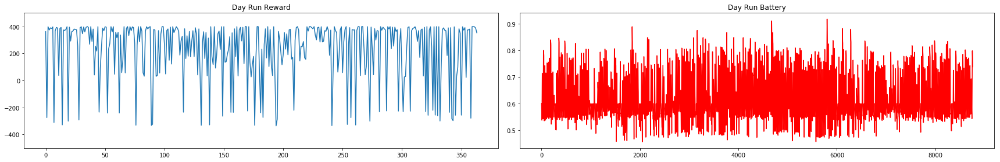


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  233.93039150508548


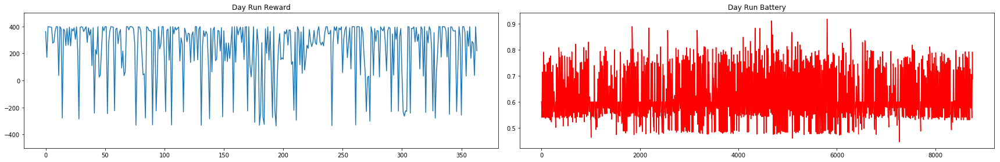

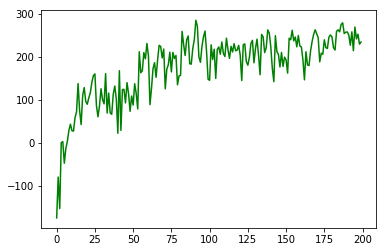

In [8]:
NO_OF_ITERATIONS = 200
avg_reward_rec = np.empty(1)

for iteration in range(NO_OF_ITERATIONS):
    if (50< iteration <= 150):
        LR = 0.1                   # learning rate
        EPSILON = 0.7              # greedy policy
    elif (150<iteration<=NO_OF_ITERATIONS):
        LR = 0.02
        EPSILON = 0.9
    else:
        LR = 0.2
        EPSILON = 0.7
    
    ############################################################################################
    #LEARN BY RESETTING BATTERY EVERYDAY
    print('\nCollecting experience... Iteration:', iteration)
    print('Learning Rate = ', LR)
    print('EPSILON = ', EPSILON)

    ps, r, done, info = eno.reset()
    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_action(s)
        ns, r, done, info = eno.step(a)

        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            terminal = True
            eno.batt = eno.BOPT
            ns = eno.getstate()
        else:
            terminal = False
        
        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        
        transition = [s,a,r,s_,a_]
        
        sarsa.learn(transition,terminal)
        if done:
            print("End of Year")
            break

        ps = ns
    
    ############################################################################################
    #TEST
    print('\nDay run test')
    ps, r, done, info = eno.reset()
    yr_test_record = np.empty(4)

    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_greedy_action(s)

        yr_test_record = np.vstack((yr_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action

        ns, r, done, info = eno.step(a)

            
        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            eno.batt = eno.BOPT
            ns = eno.getstate()

        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        

        if done:
            print("End of Year")
            break

        ps = ns

    yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
    yr_test_reward_rec = yr_test_record[:,2]
    yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]
    print("Average Reward: ", np.mean(yr_test_reward_rec))
    avg_reward_rec = np.append(avg_reward_rec, np.mean(yr_test_reward_rec))


    ############################################################################################
    #PLOT
    fig = plt.figure(figsize=(24,4))
    ax1 = fig.add_subplot(121)
    ax1.plot(yr_test_reward_rec)
    ax1.set_title("Day Run Reward")
    ax1.set_ylim([-500,500])

    ax2 = fig.add_subplot(122)
    ax2.plot(yr_test_record[:,0],'r')
    ax2.set_title("Day Run Battery")
    # ax2.set_ylim([0,1])

    fig.tight_layout()
    plt.show()

#PLOT THE AVERAGE REWARD OVER THE ITERATIONS
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
plt.plot(avg_reward_rec,'g')

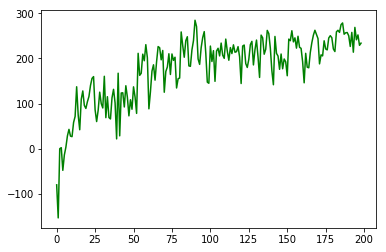

In [9]:
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
fig2 = plt.figure()
plt.plot(avg_reward_rec,'g')

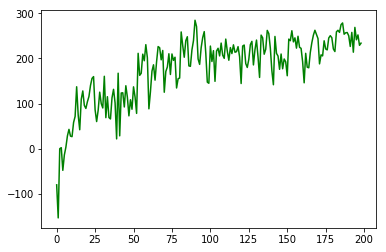

In [10]:
plt.plot(avg_reward_rec,'g')

In [11]:
avg_reward_rec

array([-8.01089701e+01, -1.53405987e+02,  2.25816721e-02,  2.29310582e+00,
       -4.79859507e+01, -1.38750938e+01,  3.43827831e+00,  2.84679073e+01,
        4.28259240e+01,  2.77422343e+01,  2.67133176e+01,  5.80109221e+01,
        7.15415924e+01,  1.37236982e+02,  7.46562774e+01,  4.19594532e+01,
        1.09651421e+02,  1.27996030e+02,  9.59487930e+01,  8.91744328e+01,
        1.04136157e+02,  1.15688982e+02,  1.40056376e+02,  1.55834548e+02,
        1.59761106e+02,  8.63048805e+01,  6.01321899e+01,  8.53446715e+01,
        1.25295093e+02,  9.99260988e+01,  9.02594681e+01,  1.60465588e+02,
        6.87299030e+01,  1.15218980e+02,  6.89983631e+01,  6.59561132e+01,
        1.12808208e+02,  1.31554186e+02,  1.01363254e+02,  2.17266082e+01,
        1.67276678e+02,  2.84718612e+01,  1.23442043e+02,  1.23867552e+02,
        9.24527684e+01,  1.39505324e+02,  1.14148129e+02,  7.27480101e+01,
        1.08493595e+02,  8.73904710e+01,  1.37056991e+02,  1.14408980e+02,
        7.82193944e+01,  

In [12]:
# # Verifying learned Q-table over a year
# print('\nYear run test')
# ps, r, done, info = eno.reset()
# yr_test_record = np.empty(4)

# while True:
#     s = sarsa.discretize(ps)
#     a = sarsa.choose_greedy_action(s)
    
# #     print("\nBatt: ", eno.batt)
# #     print("Henergy: ", eno.henergy)
# #     print("Action: ", (a+1)/10*DMAX)

#     yr_test_record = np.vstack((yr_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action
# #     print("**************")
# #     print("Batt: ", ps[0])
# #     print("Henergy: ", ps[2])
# #     print("Action: ", a)


#     ns, r, done, info = eno.step(a)
    
#     if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
#         terminal = True
#     else:
#         terminal = False
    
#     s_ = sarsa.discretize(ns)
#     a_ = sarsa.choose_action(s_)        
# #     transition = [s,a,r,s_,a_]

# #     sarsa.learn(transition,terminal)
#     if done:
#         print("End of Year")
#         break

#     ps = ns

# yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage

In [13]:
# yr_test_reward_rec = yr_test_record[:,2]
# yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]

# day_test_reward_rec = day_test_record[:,2]
# day_test_reward_rec = day_test_reward_rec[day_test_reward_rec != 0]


# fig = plt.figure(figsize=(24,4))
# ax1 = fig.add_subplot(221)
# ax1.plot(yr_test_reward_rec)
# ax1.set_title("Year Run Reward")
# # ax1.set_ylim([-400,400])

# ax2 = fig.add_subplot(222)
# ax2.plot(yr_test_record[:,0],'r')
# ax2.set_title("Year Run Battery")
# # ax2.set_ylim([0,1])

# ax3 = fig.add_subplot(223)
# ax3.plot(day_test_reward_rec)
# ax3.set_title("Day Run Reward")
# # ax3.set_ylim([-400,400])

# ax4 = fig.add_subplot(224)
# ax4.plot(day_test_record[:,0],'r')
# ax4.set_title("Day Run Battery")
# # ax4.set_ylim([0,1])

# fig.tight_layout()

In [14]:
# TIME_AXIS = np.arange(0,eno.TIME_STEPS)
# for DAY in range(eno.NO_OF_DAYS):
#     START = DAY*24
#     END = START+24

#     fig = plt.figure(figsize=(16,4))
#     st = fig.suptitle("DAY %s" %(DAY))

#     ax2 = fig.add_subplot(131)
#     ax2.plot(yr_test_record[START:END,1],'g')
#     ax2.set_title("Harvested Energy")
#     plt.xlabel("Hour")
#     ax2.set_ylim([0,1.2])

#     #plot battery for year run
#     ax1 = fig.add_subplot(132)
#     ax1.plot(TIME_AXIS,yr_test_record[START:END,0],'r') 
#     ax1.plot(TIME_AXIS, np.ones(eno.TIME_STEPS)*eno.BOPT/eno.BMAX,'r--')
#     ax1.set_title("YEAR RUN")
#     if END < (eno.NO_OF_DAYS*eno.TIME_STEPS):
#         ax1.text(12, 0, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=11, ha='center')
#     plt.xlabel("Hour")
#     ax1.set_ylabel('Battery', color='r',fontsize=12)
#     ax1.set_ylim([0,1.2])

#     #plot actions for year run
#     ax1a = ax1.twinx()
#     ax1a.plot(yr_test_record[START:END,3])
#     ax1a.set_ylim([0,N_ACTIONS])
#     ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)

    
    
#     #plot battery for day run
#     ax3 = fig.add_subplot(133)
#     ax3.plot(TIME_AXIS,day_test_record[START:END,0],'r') 
#     ax3.plot(TIME_AXIS, np.ones(eno.TIME_STEPS)*eno.BOPT/eno.BMAX,'r--')
#     ax3.set_title("DAY RUN")
#     if END < (eno.NO_OF_DAYS*eno.TIME_STEPS):
#         ax3.text(12, 0, "REWARD = %.2f\n" %(day_test_record[END,2]),fontsize=11, ha='center')
#     plt.xlabel("Hour")
#     ax3.set_ylabel('Battery', color='r',fontsize=12)
#     ax3.set_ylim([0,1.2])
    
#     #plot actions for day run
#     ax3a = ax3.twinx()
#     ax3a.plot(day_test_record[START:END,3])
#     ax3a.set_ylim([0,N_ACTIONS])
#     ax3a.set_ylabel('Duty Cycle', color='b',fontsize=12)

#     fig.tight_layout()
#     st.set_y(0.95)
#     fig.subplots_adjust(top=0.75)
#     plt.show()